# CSE 576 (Spring 2020) Homework 4

Welcome friends, it's time for Deep Learning with PyTorch! This homework might need a longer running time. 
Keep this in mind and start early.

PyTorch is a deep learning framework for fast, flexible experimentation. We are going to use it to train our classifiers.

For this homework you need to turn in this file `hw4.ipynb` after running your results and answering questions in-line.

**Notes**: 
 - This assignment was designed to be used with Google Colab, but feel free to set up your own environment if you wish. Just bear in mind that we cannot provide support for custom environments.
 - Feel free to create new cells as needed, but please **do not delete existing cells**.

Before you get started, we suggest you do the [PyTorch tutorial first](https://github.com/param087/Pytorch-tutorial-on-Google-colab).

You should at least do the 60 Minute Blitz up until "Training a Classifier".

**How to use this notebook:**
 - Each cell with a grey background is executable.
 - They can be executed by pressing the "Play" button or by hitting `Shift+Enter`
 - Cells can be executed out of order.
 - You can add new cells by clicking on the `+ Code` button in the header.
 - Made a mistake a need to start over? Click *(Runtime => Restart runtime)*
 - Check out this [Colab Introduction](https://colab.research.google.com/notebooks/intro.ipynb#scrollTo=5fCEDCU_qrC0) if you're having trouble.


 This will make sure that your progress will be saved to your Google Drive, and won't be lost if your browser refreshes for some reason. 

## Setup

This will set up the environment without GPUs. This is the recommended setup.

In [2]:
! pip install torch==1.5.0+cpu torchvision==0.6.0+cpu -f https://download.pytorch.org/whl/torch_stable.html 
! pip install tqdm matplotlib

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |████████████████████████████████| 127.3MB 95kB/s 
     |████████████████████████████████| 5.7MB 27.8MB/s 
  Found existing installation: torch 1.5.0+cu101
    Uninstalling torch-1.5.0+cu101:
      Successfully uninstalled torch-1.5.0+cu101
  Found existing installation: torchvision 0.6.0+cu101
    Uninstalling torchvision-0.6.0+cu101:
      Successfully uninstalled torchvision-0.6.0+cu101


In [0]:
# We're not using the GPU.
use_gpu = False

### With GPUs
If you're feeling adventurous you can use GPUs to accelerate training. Follow the following steps. Just note that GPUs might not be available. The course staff also can't provide support for GPU-related issues so if you're having trouble please just use the CPU runtime.

 1. Go to Runtime > Change runtime type and select 'GPU'
 2. Restart the Runtime, uncomment the commands below and run them.

In [0]:
# Install the necessary packages

# ! pip install torch==1.5.0+cu101 torchvision==0.6.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html 
# ! pip install tqdm matplotlib

If you want to use the GPU, uncomment the line below and run it.

In [0]:
# Uncomment this and execute if you're using the GPU.
# use_gpu = True

### Check that things are working.

In [4]:
# Make sure things work.

import torch

if use_gpu:
    print(torch.zeros(10).cuda())
else:
    print(torch.zeros(10))

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])


 ## Initialize Datasets

 This code defines the data loaders that will be used to train and test our networks. It also defines data augmentation functions.

In [5]:
import torch
import torchvision
from torchvision import transforms

classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

default_train_transform = transforms.Compose([
    transforms.ToTensor(),
    # Normalize rescales and shifts the data so that it has a zero mean 
    # and unit variance. This reduces bias and makes it easier to learn!
    # The values here are the mean and variance of our inputs.
    # This will change the input images to be centered at 0 and be 
    # between -1 and 1.
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

default_test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), 
])


def get_train_loader(batch_size, transform=default_train_transform):
    trainset = torchvision.datasets.CIFAR10(
        root='./data', 
        train=True, 
        download=True, 
        transform=transform)
    return torch.utils.data.DataLoader(
        trainset, batch_size=batch_size, shuffle=True, num_workers=4)


def get_test_loader(batch_size, transform=default_test_transform):
    testset = torchvision.datasets.CIFAR10(
        root='./data', 
        train=False, 
        download=True, 
        transform=transform) 
    return torch.utils.data.DataLoader(
        testset, batch_size=batch_size, shuffle=False, num_workers=4)


# This downloads the datasets.
get_train_loader(1)
get_test_loader(1);

Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


## Define code that trains and tests code.

This code will train your model. Feel free to read the code below, but we suggest you don't modify it unless you know what you're doing.

In [0]:
from matplotlib import pyplot as plt
from tqdm.auto import tqdm

# The function we'll call to train the network each epoch
def train(net, loader, optimizer, criterion, epoch, use_gpu=False):
    running_loss = 0.0
    total_loss = 0.0

    # Send the network to the correct device
    if use_gpu:
        net = net.cuda()
    else:
        net = net.cpu()

    # tqdm is a useful package for adding a progress bar to your loops
    pbar = tqdm(loader)
    for i, data in enumerate(pbar):
        inputs, labels = data

        # If we're using the GPU, send the data to the GPU
        if use_gpu:
            inputs, labels = inputs.cuda(), labels.cuda()

        optimizer.zero_grad()  # Set the gradients of the parameters to zero.
        outputs = net(inputs)  # Forward pass (send the images through the network)
        loss = criterion(outputs, labels)  # Compute the loss w.r.t the labels.
        loss.backward()  # Backward pass (compute gradients).
        optimizer.step()  # Use the gradients to update the weights of the network.

        running_loss += loss.item()
        total_loss += loss.item()
        pbar.set_description(f"[epoch {epoch+1}] loss = {running_loss/(i+1):.03f}")
    
    average_loss = total_loss / (i + 1)
    tqdm.write(f"Epoch {epoch} summary -- loss = {average_loss:.03f}")
    
    return average_loss


This code will evaluate the performance of you network. It won't update the weights, just compute from evaluation metrics.

In [0]:
from collections import defaultdict
from torchvision.utils import make_grid
from PIL import Image
from IPython import display as ipd


def show_hard_negatives(hard_negatives, label, nrow=10):
    """Visualizes hard negatives"""
    grid = make_grid([(im+1)/2 for im, score in hard_negatives[label]], 
                     nrow=nrow, padding=1)
    grid = grid.permute(1, 2, 0).mul(255).byte().numpy()
    ipd.display(Image.fromarray((grid)))


# The function we'll call to test the network
def test(net, loader, tag='', use_gpu=False, num_hard_negatives=10):
    correct = 0
    total = 0

    # Send the network to the correct device
    net = net.cuda() if use_gpu else net.cpu()

    # Compute the overall accuracy of the network
    with torch.no_grad():
        for data in tqdm(loader, desc=f"Evaluating {tag}"):
            images, labels = data

            # If we're using the GPU, send the data to the GPU
            if use_gpu:
                images = images.cuda()
                labels = labels.cuda()

            # Forward pass (send the images through the network)
            outputs = net(images)

            # Take the output of the network, and extract the index 
            # of the largest prediction for each example
            _, predicted = torch.max(outputs.data, 1)

            # Count the number of correct predictions
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    average_accuracy = correct/total
    tqdm.write(f'{tag} accuracy of the network: {100*average_accuracy:.02f}%')

    # Repeat above, but estimate the testing accuracy for each of the labels
    class_correct = list(0. for i in range(10))
    class_total = list(0. for i in range(10))
    hard_negatives = defaultdict(list)
    with torch.no_grad():
        for data in loader:
            images, labels = data
            if use_gpu:
                images = images.cuda()
                labels = labels.cuda()
            outputs = net(images)
            predicted_scores, predicted_labels = torch.max(outputs, 1)
            correct_mask = (predicted_labels == labels).squeeze()
            incorrect_mask = ~correct_mask
            unique_labels, unique_counts = torch.unique(labels, return_counts=True)
            for l, c in zip(unique_labels, unique_counts):
                l = l.item()
                label_mask = (labels == l)
                predicted_mask = (predicted_labels == l)
                # This keeps track of the most hardest negatives
                # i.e. mistakes with the highest confidence.
                hard_negative_mask = (~correct_mask & predicted_mask)
                if hard_negative_mask.sum() > 0:
                    hard_negatives[l].extend([
                        (im, score.item()) 
                        for im, score in zip(images[hard_negative_mask], 
                                             predicted_scores[hard_negative_mask])])
                    hard_negatives[l].sort(key=lambda x: x[1], reverse=True)
                    hard_negatives[l] = hard_negatives[l][:num_hard_negatives]
                class_correct[l] += (correct_mask & label_mask).sum()
                class_total[l] += c


    for i in range(10):
        tqdm.write(f'{tag} accuracy of {classes[i]} = {100*class_correct[i]/class_total[i]:.02f}%')
        if len(hard_negatives[i]) > 0:
            print(f'Hard negatives for {classes[i]}')
            show_hard_negatives(hard_negatives, i, nrow=10)
        else:
            print("There were no hard negatives--perhaps the model got 0% accuracy?")

    
    return average_accuracy

This is a wrapper function we provide that handles all the book keeping. It will train your network for an epoch and then test it every couple epochs.

In [0]:
def train_network(net, 
                  lr, 
                  epochs, 
                  batch_size, 
                  criterion=None,
                  lr_func=None,
                  train_transform=default_train_transform, 
                  eval_interval=10,
                  use_gpu=use_gpu): 
    # Initialize the optimizer
    optimizer = optim.SGD(net.parameters(), lr=lr)

    # Initialize the loss function
    if criterion is None:
        # Note that CrossEntropyLoss has the Softmax built in!
        # This is good for numerical stability. 
        # Read: https://pytorch.org/docs/stable/nn.html#torch.nn.CrossEntropyLoss
        criterion = nn.CrossEntropyLoss()

    # Initialize the data loaders
    train_loader = get_train_loader(batch_size, transform=train_transform)
    test_loader = get_test_loader(batch_size)
    
    train_losses = []
    train_accuracies = []
    test_accuracies = []

    for epoch in range(epochs):  # loop over the dataset multiple times
        if lr_func is not None:
            lr_func(optimizer, epoch, lr)

        train_loss = train(net, train_loader, optimizer, criterion, epoch, use_gpu=use_gpu)
        train_losses.append(train_loss)

        # Evaluate the model every `eval_interval` epochs.
        if (epoch + 1) % eval_interval == 0:
            print(f"Evaluating epoch {epoch+1}")
            train_accuracy = test(net, train_loader, 'Train', use_gpu=use_gpu)
            test_accuracy = test(net, test_loader, 'Test', use_gpu=use_gpu)
            train_accuracies.append(train_accuracy)
            test_accuracies.append(test_accuracy)
    
    return train_losses, train_accuracies, test_accuracies
    

# A function to plot the losses over time
def plot_results(train_losses, train_accuracies, test_accuracies):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    axes[0].plot(train_losses)
    axes[0].set_title('Training Loss')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Loss')
    
    axes[1].plot(train_accuracies)
    axes[1].set_title('Training Accuracy')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Accuracy')
    
    axes[2].plot(test_accuracies)
    axes[2].set_title('Testing Accuracy')
    axes[2].set_xlabel('Epoch')
    axes[2].set_ylabel('Accuracy')



## 2.1. Training a classifier using only one fully connected Layer

Implement a model to classify the images from Cifar-10 into ten categories using just one fully connected layer (remember that fully connected layers are called Linear in PyTorch).

If you are new to PyTorch you may want to check out the tutorial on MNIST [here](https://pytorch.org/tutorials/beginner/blitz/neural_networks_tutorial.html#sphx-glr-beginner-blitz-neural-networks-tutorial-py).

Fill in the code for LazyNet here.

**Hints:**
 - Note that `nn.CrossEntropyLoss` has the Softmax built in for numerical stability. This means that the output layer of your network should be linear and not contain a Softmax. You can read more about it [here](https://pytorch.org/docs/stable/nn.html#torch.nn.CrossEntropyLoss)
 - You can use the `view()` function to flatten your input image to a vector e.g., if `x` is a `(100,3,4,4)` tensor then `x.view(-1, 3*4*4)` will flatten it into a vector of size `48`.
 - The images in MNIST are 32x32.

In [0]:
from torch import nn
from torch import optim

import torch.nn.functional as F
class LazyNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.fc1 = nn.Linear(3 * 32 * 32, 10)

    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = x.view(-1, 3 * 32 * 32)
        x = F.relu(self.fc1(x))
        
        return x


net = LazyNet()
net

LazyNet(
  (fc1): Linear(in_features=3072, out_features=10, bias=True)
)

#### Run the model for 15 epochs and report the plots and accuracies.

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 3.726



Epoch 1 summary -- loss = 3.062



Epoch 2 summary -- loss = 2.867



Epoch 3 summary -- loss = 2.755



Epoch 4 summary -- loss = 2.680
Evaluating epoch 5



Train accuracy of the network: 35.45%
Train accuracy of plane = 49.04%
Hard negatives for plane


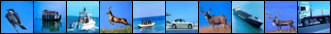

Train accuracy of car = 41.02%
Hard negatives for car


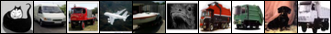

Train accuracy of bird = 13.60%
Hard negatives for bird


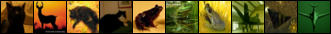

Train accuracy of cat = 15.74%
Hard negatives for cat


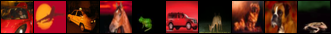

Train accuracy of deer = 30.52%
Hard negatives for deer


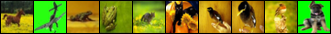

Train accuracy of dog = 34.34%
Hard negatives for dog


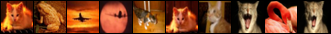

Train accuracy of frog = 44.06%
Hard negatives for frog


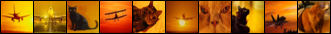

Train accuracy of horse = 35.80%
Hard negatives for horse


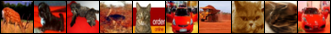

Train accuracy of ship = 47.56%
Hard negatives for ship


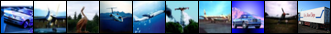

Train accuracy of truck = 42.86%
Hard negatives for truck


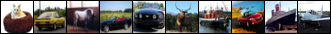


Test accuracy of the network: 35.12%
Test accuracy of plane = 52.30%
Hard negatives for plane


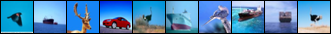

Test accuracy of car = 40.80%
Hard negatives for car


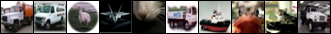

Test accuracy of bird = 12.20%
Hard negatives for bird


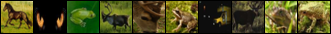

Test accuracy of cat = 13.60%
Hard negatives for cat


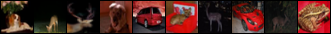

Test accuracy of deer = 28.90%
Hard negatives for deer


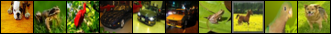

Test accuracy of dog = 31.60%
Hard negatives for dog


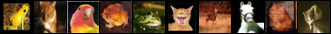

Test accuracy of frog = 45.40%
Hard negatives for frog


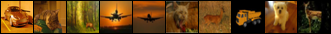

Test accuracy of horse = 35.50%
Hard negatives for horse


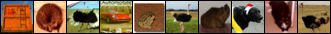

Test accuracy of ship = 48.90%
Hard negatives for ship


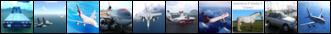

Test accuracy of truck = 42.00%
Hard negatives for truck


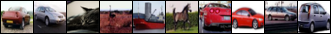


Epoch 5 summary -- loss = 2.626



Epoch 6 summary -- loss = 2.585



Epoch 7 summary -- loss = 2.552



Epoch 8 summary -- loss = 2.525



Epoch 9 summary -- loss = 2.503
Evaluating epoch 10



Train accuracy of the network: 38.08%
Train accuracy of plane = 48.74%
Hard negatives for plane


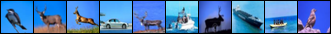

Train accuracy of car = 44.50%
Hard negatives for car


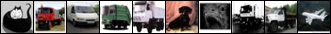

Train accuracy of bird = 19.94%
Hard negatives for bird


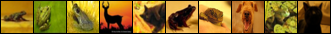

Train accuracy of cat = 20.84%
Hard negatives for cat


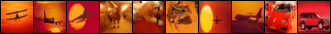

Train accuracy of deer = 30.80%
Hard negatives for deer


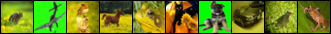

Train accuracy of dog = 34.58%
Hard negatives for dog


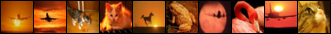

Train accuracy of frog = 45.32%
Hard negatives for frog


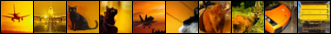

Train accuracy of horse = 40.68%
Hard negatives for horse


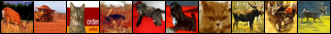

Train accuracy of ship = 50.40%
Hard negatives for ship


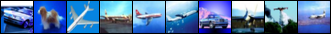

Train accuracy of truck = 45.02%
Hard negatives for truck


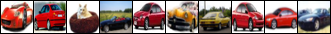


Test accuracy of the network: 37.49%
Test accuracy of plane = 51.40%
Hard negatives for plane


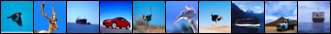

Test accuracy of car = 41.40%
Hard negatives for car


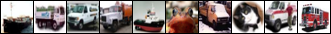

Test accuracy of bird = 17.70%
Hard negatives for bird


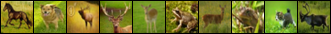

Test accuracy of cat = 20.40%
Hard negatives for cat


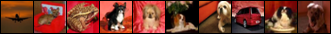

Test accuracy of deer = 30.60%
Hard negatives for deer


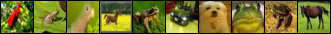

Test accuracy of dog = 31.90%
Hard negatives for dog


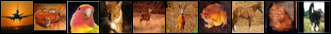

Test accuracy of frog = 46.70%
Hard negatives for frog


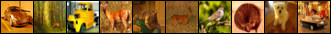

Test accuracy of horse = 39.90%
Hard negatives for horse


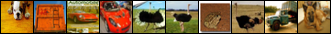

Test accuracy of ship = 51.00%
Hard negatives for ship


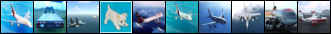

Test accuracy of truck = 43.90%
Hard negatives for truck


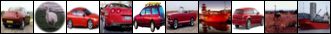


Epoch 10 summary -- loss = 2.484



Epoch 11 summary -- loss = 2.468



Epoch 12 summary -- loss = 2.454



Epoch 13 summary -- loss = 2.441



Epoch 14 summary -- loss = 2.429
Evaluating epoch 15



Train accuracy of the network: 39.07%
Train accuracy of plane = 48.48%
Hard negatives for plane


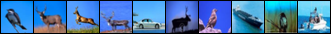

Train accuracy of car = 45.86%
Hard negatives for car


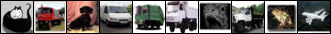

Train accuracy of bird = 19.84%
Hard negatives for bird


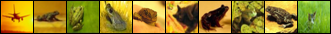

Train accuracy of cat = 22.52%
Hard negatives for cat


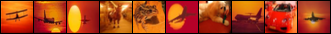

Train accuracy of deer = 33.88%
Hard negatives for deer


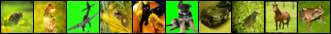

Train accuracy of dog = 34.12%
Hard negatives for dog


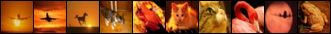

Train accuracy of frog = 46.46%
Hard negatives for frog


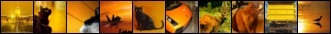

Train accuracy of horse = 41.44%
Hard negatives for horse


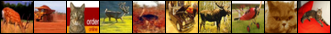

Train accuracy of ship = 51.70%
Hard negatives for ship


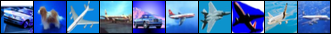

Train accuracy of truck = 46.44%
Hard negatives for truck


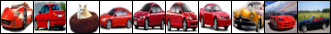


Test accuracy of the network: 38.16%
Test accuracy of plane = 51.00%
Hard negatives for plane


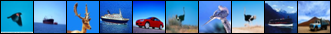

Test accuracy of car = 41.80%
Hard negatives for car


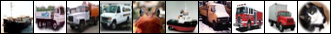

Test accuracy of bird = 17.50%
Hard negatives for bird


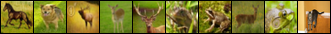

Test accuracy of cat = 21.20%
Hard negatives for cat


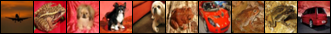

Test accuracy of deer = 31.80%
Hard negatives for deer


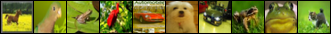

Test accuracy of dog = 32.80%
Hard negatives for dog


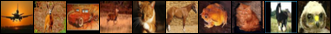

Test accuracy of frog = 47.20%
Hard negatives for frog


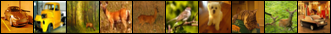

Test accuracy of horse = 40.70%
Hard negatives for horse


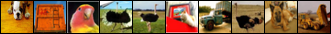

Test accuracy of ship = 51.80%
Hard negatives for ship


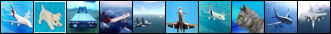

Test accuracy of truck = 45.80%
Hard negatives for truck


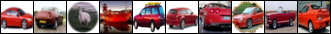

In [0]:
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=15,
    eval_interval=5,
    batch_size=1024)

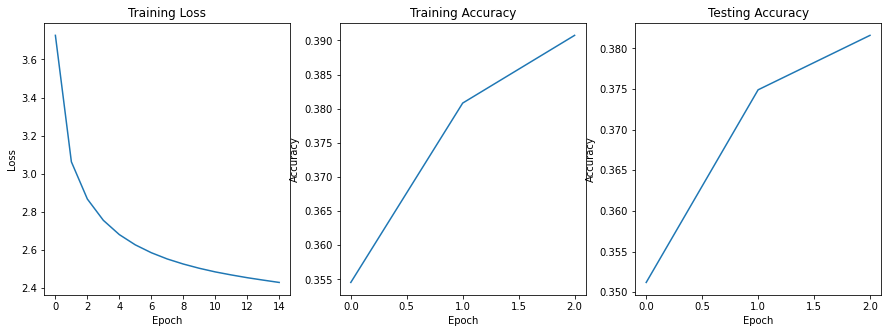

In [0]:
plot_results(train_losses, train_accuracies, test_accuracies)

## 2.2. Training a classifier using multiple fully connected layers ##

Implement a model for the same classification task using multiple fully connected layers.

Start with a fully connected layer that maps the data from image size (32 * 32 * 3) to a vector of size 120, followed by another fully connected that reduces the size to 84 and finally a layer that maps the vector of size 84 to 10 classes.

Use any activation you want.

Fill in the code for BoringNet below.

In [0]:
class BoringNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.fc1 = nn.Linear(3 * 32 * 32, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = x.view(-1, 3 * 32 * 32)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

net = BoringNet()
net

BoringNet(
  (fc1): Linear(in_features=3072, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
)

### Run the model for 30 epochs and report the plots and accuracies.

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.285



Epoch 1 summary -- loss = 2.250



Epoch 2 summary -- loss = 2.207



Epoch 3 summary -- loss = 2.162



Epoch 4 summary -- loss = 2.119



Epoch 5 summary -- loss = 2.082



Epoch 6 summary -- loss = 2.048



Epoch 7 summary -- loss = 2.017



Epoch 8 summary -- loss = 1.990



Epoch 9 summary -- loss = 1.964
Evaluating epoch 10



Train accuracy of the network: 31.20%
Train accuracy of plane = 43.38%
Hard negatives for plane


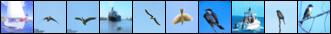

Train accuracy of car = 23.08%
Hard negatives for car


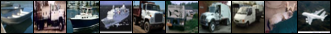

Train accuracy of bird = 6.48%
Hard negatives for bird


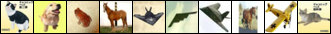

Train accuracy of cat = 1.78%
Hard negatives for cat


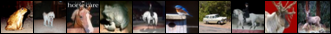

Train accuracy of deer = 30.20%
Hard negatives for deer


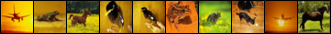

Train accuracy of dog = 27.58%
Hard negatives for dog


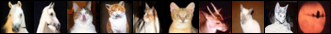

Train accuracy of frog = 52.48%
Hard negatives for frog


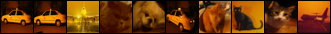

Train accuracy of horse = 25.54%
Hard negatives for horse


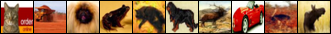

Train accuracy of ship = 51.56%
Hard negatives for ship


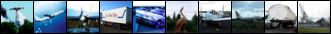

Train accuracy of truck = 49.92%
Hard negatives for truck


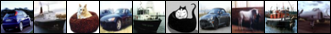


Test accuracy of the network: 31.49%
Test accuracy of plane = 46.80%
Hard negatives for plane


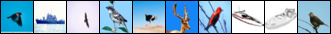

Test accuracy of car = 23.50%
Hard negatives for car


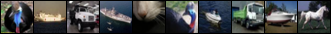

Test accuracy of bird = 5.90%
Hard negatives for bird


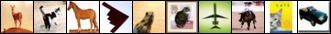

Test accuracy of cat = 1.30%
Hard negatives for cat


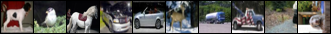

Test accuracy of deer = 29.30%
Hard negatives for deer


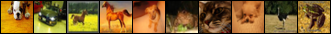

Test accuracy of dog = 27.80%
Hard negatives for dog


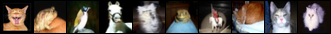

Test accuracy of frog = 53.50%
Hard negatives for frog


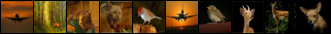

Test accuracy of horse = 25.10%
Hard negatives for horse


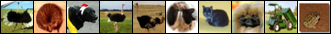

Test accuracy of ship = 51.60%
Hard negatives for ship


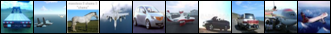

Test accuracy of truck = 50.10%
Hard negatives for truck


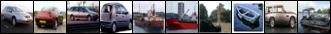


Epoch 10 summary -- loss = 1.941



Epoch 11 summary -- loss = 1.919



Epoch 12 summary -- loss = 1.899



Epoch 13 summary -- loss = 1.880



Epoch 14 summary -- loss = 1.863



Epoch 15 summary -- loss = 1.848



Epoch 16 summary -- loss = 1.833



Epoch 17 summary -- loss = 1.819



Epoch 18 summary -- loss = 1.807



Epoch 19 summary -- loss = 1.795
Evaluating epoch 20



Train accuracy of the network: 36.85%
Train accuracy of plane = 43.94%
Hard negatives for plane


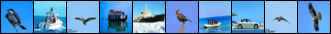

Train accuracy of car = 41.44%
Hard negatives for car


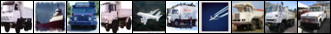

Train accuracy of bird = 15.76%
Hard negatives for bird


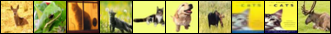

Train accuracy of cat = 8.00%
Hard negatives for cat


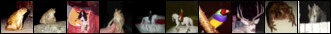

Train accuracy of deer = 33.92%
Hard negatives for deer


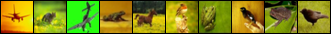

Train accuracy of dog = 37.96%
Hard negatives for dog


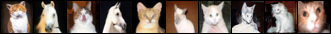

Train accuracy of frog = 49.96%
Hard negatives for frog


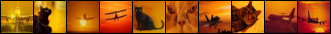

Train accuracy of horse = 35.22%
Hard negatives for horse


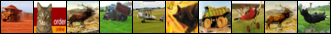

Train accuracy of ship = 53.00%
Hard negatives for ship


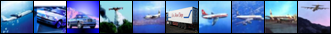

Train accuracy of truck = 49.32%
Hard negatives for truck


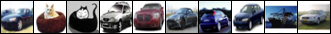


Test accuracy of the network: 36.98%
Test accuracy of plane = 45.90%
Hard negatives for plane


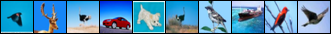

Test accuracy of car = 42.70%
Hard negatives for car


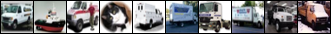

Test accuracy of bird = 16.10%
Hard negatives for bird


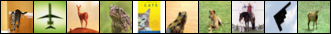

Test accuracy of cat = 8.00%
Hard negatives for cat


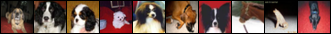

Test accuracy of deer = 34.10%
Hard negatives for deer


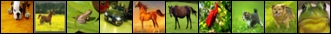

Test accuracy of dog = 36.30%
Hard negatives for dog


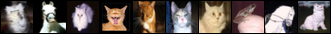

Test accuracy of frog = 49.70%
Hard negatives for frog


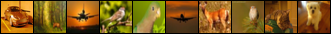

Test accuracy of horse = 36.00%
Hard negatives for horse


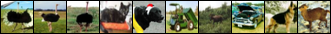

Test accuracy of ship = 52.80%
Hard negatives for ship


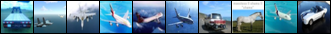

Test accuracy of truck = 48.20%
Hard negatives for truck


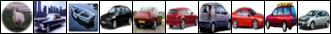


Epoch 20 summary -- loss = 1.783



Epoch 21 summary -- loss = 1.772



Epoch 22 summary -- loss = 1.762



Epoch 23 summary -- loss = 1.752



Epoch 24 summary -- loss = 1.743



Epoch 25 summary -- loss = 1.734



Epoch 26 summary -- loss = 1.725



Epoch 27 summary -- loss = 1.717



Epoch 28 summary -- loss = 1.709



Epoch 29 summary -- loss = 1.701
Evaluating epoch 30



Train accuracy of the network: 40.04%
Train accuracy of plane = 45.56%
Hard negatives for plane


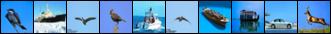

Train accuracy of car = 47.36%
Hard negatives for car


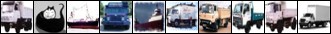

Train accuracy of bird = 23.82%
Hard negatives for bird


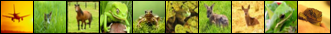

Train accuracy of cat = 17.02%
Hard negatives for cat


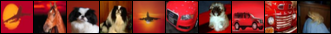

Train accuracy of deer = 31.36%
Hard negatives for deer


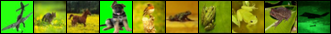

Train accuracy of dog = 35.42%
Hard negatives for dog


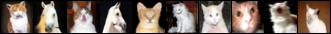

Train accuracy of frog = 53.66%
Hard negatives for frog


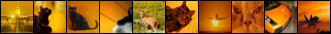

Train accuracy of horse = 41.88%
Hard negatives for horse


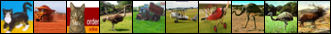

Train accuracy of ship = 55.52%
Hard negatives for ship


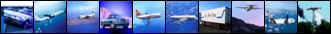

Train accuracy of truck = 48.78%
Hard negatives for truck


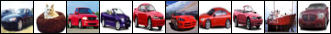


Test accuracy of the network: 40.04%
Test accuracy of plane = 46.50%
Hard negatives for plane


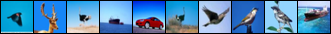

Test accuracy of car = 48.70%
Hard negatives for car


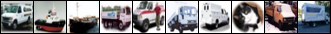

Test accuracy of bird = 24.00%
Hard negatives for bird


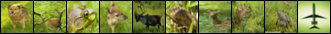

Test accuracy of cat = 16.30%
Hard negatives for cat


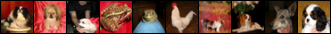

Test accuracy of deer = 30.00%
Hard negatives for deer


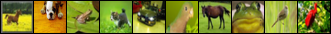

Test accuracy of dog = 34.60%
Hard negatives for dog


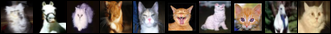

Test accuracy of frog = 54.40%
Hard negatives for frog


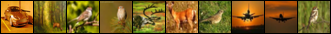

Test accuracy of horse = 42.30%
Hard negatives for horse


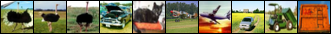

Test accuracy of ship = 55.00%
Hard negatives for ship


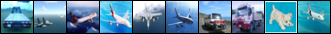

Test accuracy of truck = 48.60%
Hard negatives for truck


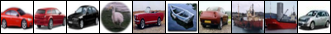

In [0]:
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1024)

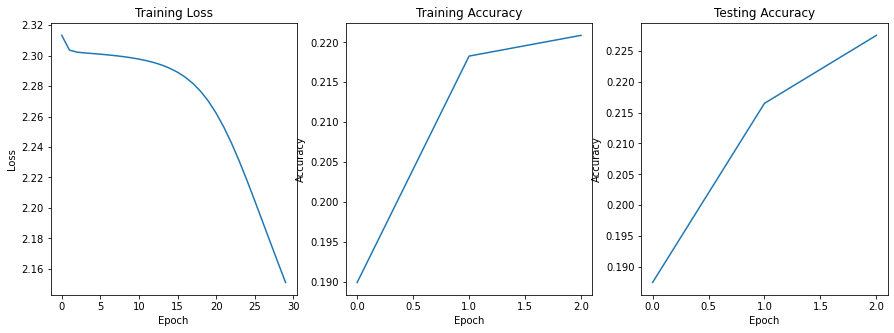

In [0]:
plot_results(train_losses, train_accuracies, test_accuracies)

### Question

Try training this model with and without activations. How does the activations (such as ReLU) affect the training process and why?


Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.217



Epoch 1 summary -- loss = 2.098



Epoch 2 summary -- loss = 2.027



Epoch 3 summary -- loss = 1.978



Epoch 4 summary -- loss = 1.943



Epoch 5 summary -- loss = 1.917



Epoch 6 summary -- loss = 1.898



Epoch 7 summary -- loss = 1.882



Epoch 8 summary -- loss = 1.868



Epoch 9 summary -- loss = 1.857
Evaluating epoch 10



Train accuracy of the network: 36.45%
Train accuracy of plane = 41.38%
Hard negatives for plane


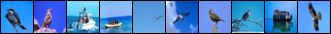

Train accuracy of car = 41.16%
Hard negatives for car


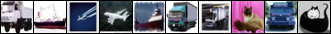

Train accuracy of bird = 17.56%
Hard negatives for bird


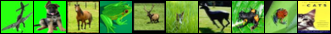

Train accuracy of cat = 10.04%
Hard negatives for cat


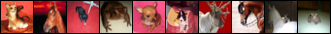

Train accuracy of deer = 32.96%
Hard negatives for deer


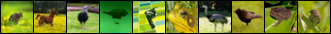

Train accuracy of dog = 35.48%
Hard negatives for dog


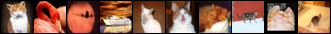

Train accuracy of frog = 49.76%
Hard negatives for frog


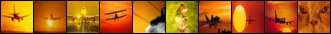

Train accuracy of horse = 33.14%
Hard negatives for horse


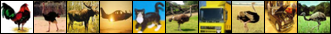

Train accuracy of ship = 52.80%
Hard negatives for ship


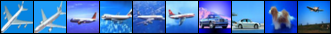

Train accuracy of truck = 50.24%
Hard negatives for truck


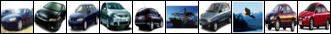


Test accuracy of the network: 36.52%
Test accuracy of plane = 42.20%
Hard negatives for plane


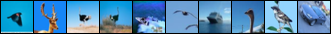

Test accuracy of car = 41.70%
Hard negatives for car


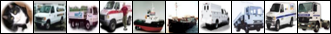

Test accuracy of bird = 18.90%
Hard negatives for bird


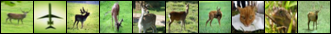

Test accuracy of cat = 11.20%
Hard negatives for cat


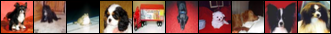

Test accuracy of deer = 30.90%
Hard negatives for deer


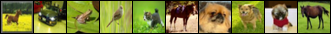

Test accuracy of dog = 33.50%
Hard negatives for dog


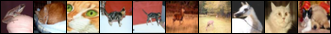

Test accuracy of frog = 51.70%
Hard negatives for frog


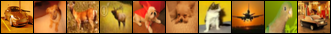

Test accuracy of horse = 32.40%
Hard negatives for horse


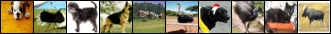

Test accuracy of ship = 53.30%
Hard negatives for ship


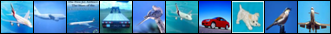

Test accuracy of truck = 49.40%
Hard negatives for truck


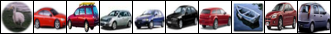


Epoch 10 summary -- loss = 1.847



Epoch 11 summary -- loss = 1.838



Epoch 12 summary -- loss = 1.830



Epoch 13 summary -- loss = 1.822



Epoch 14 summary -- loss = 1.815



Epoch 15 summary -- loss = 1.809



Epoch 16 summary -- loss = 1.803



Epoch 17 summary -- loss = 1.797



Epoch 18 summary -- loss = 1.792



Epoch 19 summary -- loss = 1.787
Evaluating epoch 20



Train accuracy of the network: 38.73%
Train accuracy of plane = 43.02%
Hard negatives for plane


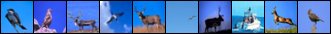

Train accuracy of car = 45.36%
Hard negatives for car


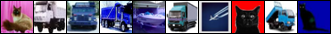

Train accuracy of bird = 20.90%
Hard negatives for bird


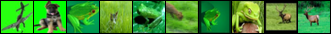

Train accuracy of cat = 20.30%
Hard negatives for cat


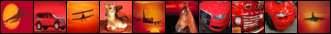

Train accuracy of deer = 29.98%
Hard negatives for deer


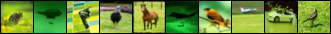

Train accuracy of dog = 33.86%
Hard negatives for dog


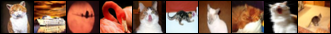

Train accuracy of frog = 51.08%
Hard negatives for frog


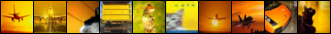

Train accuracy of horse = 40.42%
Hard negatives for horse


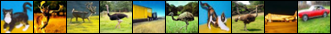

Train accuracy of ship = 52.64%
Hard negatives for ship


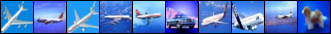

Train accuracy of truck = 49.70%
Hard negatives for truck


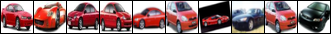


Test accuracy of the network: 38.68%
Test accuracy of plane = 44.20%
Hard negatives for plane


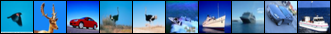

Test accuracy of car = 45.70%
Hard negatives for car


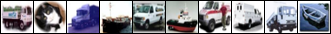

Test accuracy of bird = 22.20%
Hard negatives for bird


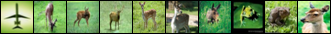

Test accuracy of cat = 19.80%
Hard negatives for cat


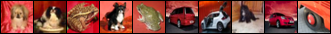

Test accuracy of deer = 29.10%
Hard negatives for deer


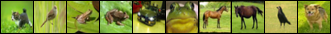

Test accuracy of dog = 32.60%
Hard negatives for dog


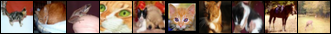

Test accuracy of frog = 51.50%
Hard negatives for frog


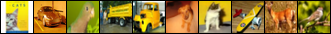

Test accuracy of horse = 40.70%
Hard negatives for horse


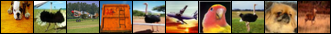

Test accuracy of ship = 52.20%
Hard negatives for ship


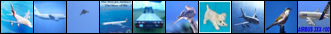

Test accuracy of truck = 48.80%
Hard negatives for truck


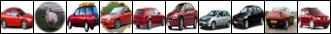


Epoch 20 summary -- loss = 1.783



Epoch 21 summary -- loss = 1.778



Epoch 22 summary -- loss = 1.775



Epoch 23 summary -- loss = 1.771



Epoch 24 summary -- loss = 1.767



Epoch 25 summary -- loss = 1.764



Epoch 26 summary -- loss = 1.760



Epoch 27 summary -- loss = 1.757



Epoch 28 summary -- loss = 1.754



Epoch 29 summary -- loss = 1.751
Evaluating epoch 30



Train accuracy of the network: 39.94%
Train accuracy of plane = 45.42%
Hard negatives for plane


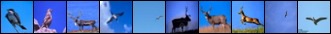

Train accuracy of car = 48.94%
Hard negatives for car


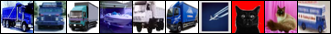

Train accuracy of bird = 22.96%
Hard negatives for bird


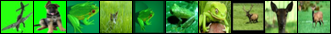

Train accuracy of cat = 23.12%
Hard negatives for cat


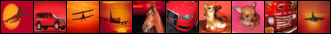

Train accuracy of deer = 29.42%
Hard negatives for deer


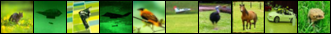

Train accuracy of dog = 33.16%
Hard negatives for dog


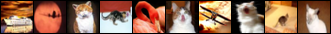

Train accuracy of frog = 52.52%
Hard negatives for frog


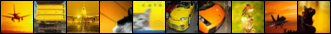

Train accuracy of horse = 42.96%
Hard negatives for horse


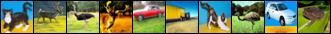

Train accuracy of ship = 52.70%
Hard negatives for ship


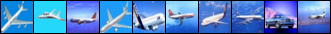

Train accuracy of truck = 48.20%
Hard negatives for truck


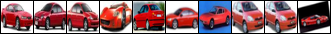


Test accuracy of the network: 39.76%
Test accuracy of plane = 46.50%
Hard negatives for plane


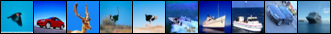

Test accuracy of car = 48.60%
Hard negatives for car


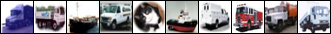

Test accuracy of bird = 22.80%
Hard negatives for bird


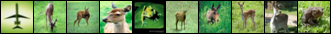

Test accuracy of cat = 22.40%
Hard negatives for cat


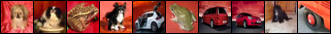

Test accuracy of deer = 29.00%
Hard negatives for deer


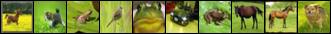

Test accuracy of dog = 32.80%
Hard negatives for dog


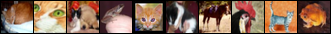

Test accuracy of frog = 53.90%
Hard negatives for frog


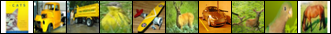

Test accuracy of horse = 43.30%
Hard negatives for horse


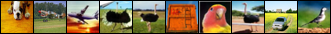

Test accuracy of ship = 51.70%
Hard negatives for ship


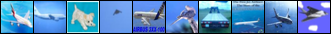

Test accuracy of truck = 46.60%
Hard negatives for truck


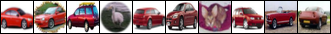

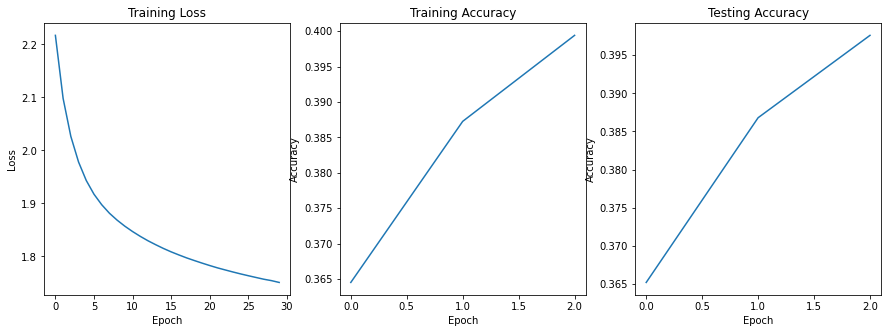

In [0]:
class BoringNet(nn.Module):
    def __init__(self):
        super().__init__()
        # TODO: Define model here
        self.fc1 = nn.Linear(3 * 32 * 32, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):
        # TODO: Implement forward pass for LazyNet
        x = x.view(-1, 3 * 32 * 32)
        x = self.fc1(x)
        x = self.fc2(x)
        x = self.fc3(x)
        return x

net = BoringNet()
net
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1024)
plot_results(train_losses, train_accuracies, test_accuracies)

Compared to model without activations,model with ReLU activation has higher training loss and higher testing accuracy.



## 2.3. Training a classifier using convolutions ##

Implement a model using convolutional, pooling and fully connected layers.

You are free to choose any parameters for these layers (we would like you to play around with some values).

Fill in the code for CoolNet below. Explain why you have chosen these layers and how they affected the performance. Analyze the behavior of your model.

In [10]:
from torch import nn
from torch import optim

import torch.nn.functional as F
class CoolNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 6, 5, padding = 2)
        self.conv2 = nn.Conv2d(6, 16, 5, padding = 2)
        
        self.fc1 = nn.Linear(16 * 8 * 8, 120)
        self.fc2 = nn.Linear(120, 10)
        #self.fc3 = nn.Linear(84, 10)
        
        # TODO: Define model here

    def forward(self, x):
        # Max pooling over a (2, 2) window
        x = F.max_pool2d(F.tanh(self.conv1(x)), (2, 2))
        x = F.max_pool2d(F.tanh(self.conv2(x)), 2)
        x = x.view(-1, self.num_flat_features(x))
        x = F.tanh(self.fc1(x))
        #x = F.relu(self.fc2(x))
        x = self.fc2(x)
        return x

    def num_flat_features(self, x):
        size = x.size()[1:]  # all dimensions except the batch dimension
        num_features = 1
        for s in size:
            num_features *= s
        return num_features

net = CoolNet()
net

CoolNet(
  (conv1): Conv2d(3, 6, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (conv2): Conv2d(6, 16, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
  (fc1): Linear(in_features=1024, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=10, bias=True)
)

### Run the model for 30 epochs and report the plots and accuracies 

Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 2.295



Epoch 1 summary -- loss = 2.263



Epoch 2 summary -- loss = 2.192



Epoch 3 summary -- loss = 2.117



Epoch 4 summary -- loss = 2.067



Epoch 5 summary -- loss = 2.032



Epoch 6 summary -- loss = 2.004



Epoch 7 summary -- loss = 1.981



Epoch 8 summary -- loss = 1.961



Epoch 9 summary -- loss = 1.944
Evaluating epoch 10



Train accuracy of the network: 30.71%
Train accuracy of plane = 43.78%
Hard negatives for plane


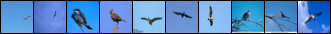

Train accuracy of car = 35.46%
Hard negatives for car


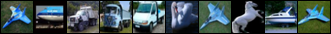

Train accuracy of bird = 0.64%
Hard negatives for bird


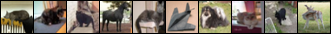

Train accuracy of cat = 6.14%
Hard negatives for cat


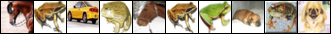

Train accuracy of deer = 3.86%
Hard negatives for deer


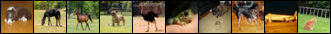

Train accuracy of dog = 35.48%
Hard negatives for dog


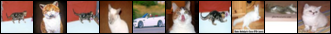

Train accuracy of frog = 66.90%
Hard negatives for frog


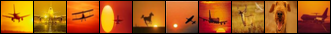

Train accuracy of horse = 25.26%
Hard negatives for horse


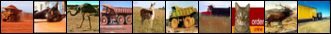

Train accuracy of ship = 45.08%
Hard negatives for ship


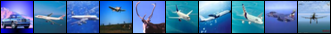

Train accuracy of truck = 44.48%
Hard negatives for truck


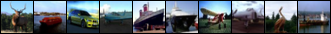


Test accuracy of the network: 31.38%
Test accuracy of plane = 47.10%
Hard negatives for plane


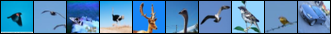

Test accuracy of car = 37.00%
Hard negatives for car


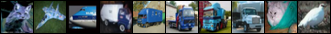

Test accuracy of bird = 0.60%
Hard negatives for bird


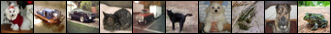

Test accuracy of cat = 5.80%
Hard negatives for cat


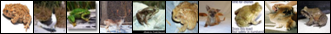

Test accuracy of deer = 3.30%
Hard negatives for deer


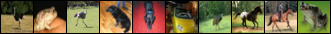

Test accuracy of dog = 36.70%
Hard negatives for dog


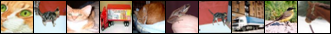

Test accuracy of frog = 68.30%
Hard negatives for frog


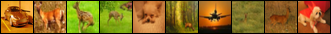

Test accuracy of horse = 26.70%
Hard negatives for horse


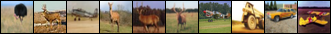

Test accuracy of ship = 44.10%
Hard negatives for ship


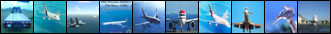

Test accuracy of truck = 44.20%
Hard negatives for truck


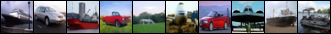


Epoch 10 summary -- loss = 1.928



Epoch 11 summary -- loss = 1.913



Epoch 12 summary -- loss = 1.899



Epoch 13 summary -- loss = 1.884



Epoch 14 summary -- loss = 1.870



Epoch 15 summary -- loss = 1.856



Epoch 16 summary -- loss = 1.842



Epoch 17 summary -- loss = 1.828



Epoch 18 summary -- loss = 1.813



Epoch 19 summary -- loss = 1.798
Evaluating epoch 20



Train accuracy of the network: 37.37%
Train accuracy of plane = 44.36%
Hard negatives for plane


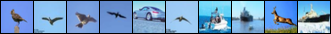

Train accuracy of car = 46.40%
Hard negatives for car


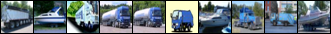

Train accuracy of bird = 9.74%
Hard negatives for bird


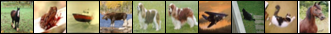

Train accuracy of cat = 14.58%
Hard negatives for cat


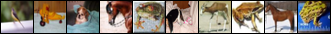

Train accuracy of deer = 23.96%
Hard negatives for deer


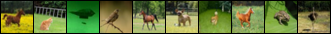

Train accuracy of dog = 37.92%
Hard negatives for dog


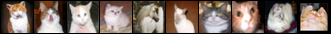

Train accuracy of frog = 58.36%
Hard negatives for frog


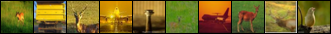

Train accuracy of horse = 41.12%
Hard negatives for horse


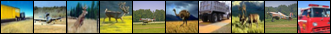

Train accuracy of ship = 50.92%
Hard negatives for ship


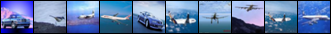

Train accuracy of truck = 46.34%
Hard negatives for truck


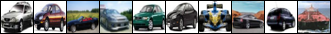


Test accuracy of the network: 37.73%
Test accuracy of plane = 46.10%
Hard negatives for plane


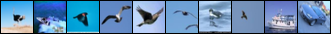

Test accuracy of car = 48.00%
Hard negatives for car


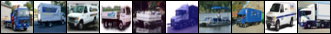

Test accuracy of bird = 9.50%
Hard negatives for bird


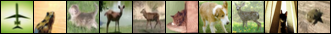

Test accuracy of cat = 13.10%
Hard negatives for cat


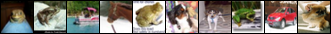

Test accuracy of deer = 23.00%
Hard negatives for deer


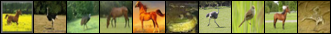

Test accuracy of dog = 38.00%
Hard negatives for dog


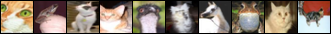

Test accuracy of frog = 60.90%
Hard negatives for frog


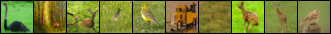

Test accuracy of horse = 41.90%
Hard negatives for horse


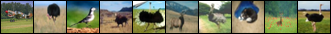

Test accuracy of ship = 51.70%
Hard negatives for ship


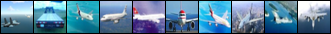

Test accuracy of truck = 45.10%
Hard negatives for truck


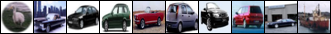


Epoch 20 summary -- loss = 1.782



Epoch 21 summary -- loss = 1.764



Epoch 22 summary -- loss = 1.745



Epoch 23 summary -- loss = 1.724



Epoch 24 summary -- loss = 1.704



Epoch 25 summary -- loss = 1.686



Epoch 26 summary -- loss = 1.671



Epoch 27 summary -- loss = 1.658



Epoch 28 summary -- loss = 1.647



Epoch 29 summary -- loss = 1.637
Evaluating epoch 30



Train accuracy of the network: 42.21%
Train accuracy of plane = 46.52%
Hard negatives for plane


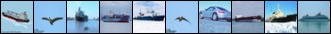

Train accuracy of car = 53.56%
Hard negatives for car


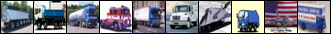

Train accuracy of bird = 25.64%
Hard negatives for bird


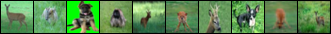

Train accuracy of cat = 18.02%
Hard negatives for cat


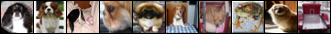

Train accuracy of deer = 35.06%
Hard negatives for deer


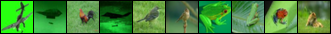

Train accuracy of dog = 36.20%
Hard negatives for dog


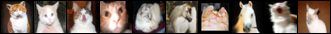

Train accuracy of frog = 55.30%
Hard negatives for frog


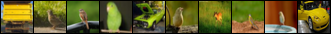

Train accuracy of horse = 46.06%
Hard negatives for horse


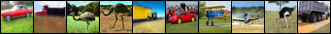

Train accuracy of ship = 54.88%
Hard negatives for ship


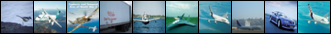

Train accuracy of truck = 50.82%
Hard negatives for truck


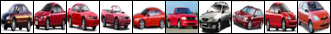


Test accuracy of the network: 42.39%
Test accuracy of plane = 47.60%
Hard negatives for plane


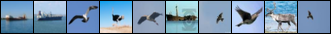

Test accuracy of car = 54.60%
Hard negatives for car


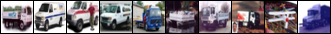

Test accuracy of bird = 26.00%
Hard negatives for bird


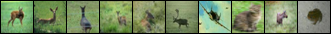

Test accuracy of cat = 17.70%
Hard negatives for cat


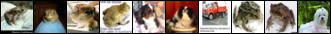

Test accuracy of deer = 33.60%
Hard negatives for deer


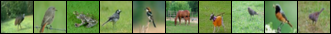

Test accuracy of dog = 35.30%
Hard negatives for dog


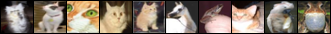

Test accuracy of frog = 59.10%
Hard negatives for frog


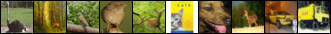

Test accuracy of horse = 47.40%
Hard negatives for horse


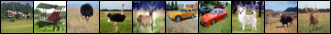

Test accuracy of ship = 55.10%
Hard negatives for ship


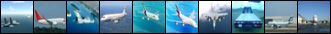

Test accuracy of truck = 47.50%
Hard negatives for truck


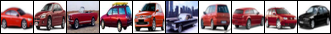

In [11]:
net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1024)

train_loss:  1.6371715628370946
train_accuracies:  0.42206
test_accuracies:  0.4239


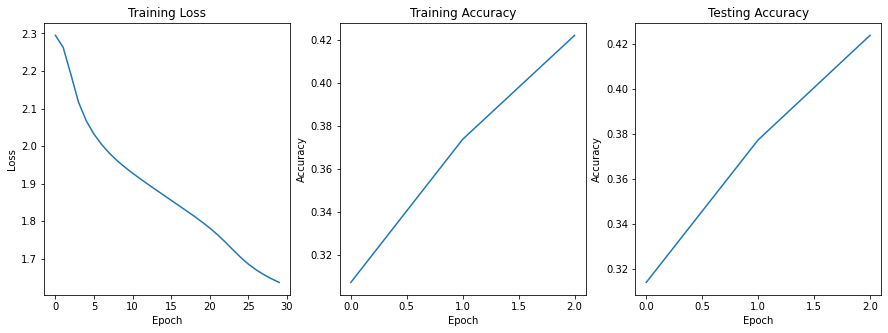

In [12]:
plot_results(train_losses, train_accuracies, test_accuracies)

print("train_loss: ",train_losses[-1])
print("train_accuracies: ",train_accuracies[-1])
print("test_accuracies: ",test_accuracies[-1])

### 2.3.1. How does batch size affect training?

Try using three different values for batch size. How do these values affect training and why?

Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 2.274



Epoch 1 summary -- loss = 2.177



Epoch 2 summary -- loss = 2.096



Epoch 3 summary -- loss = 2.037



Epoch 4 summary -- loss = 1.980



Epoch 5 summary -- loss = 1.930



Epoch 6 summary -- loss = 1.887



Epoch 7 summary -- loss = 1.844



Epoch 8 summary -- loss = 1.800



Epoch 9 summary -- loss = 1.757
Evaluating epoch 10



Train accuracy of the network: 39.00%
Train accuracy of plane = 46.12%
Hard negatives for plane


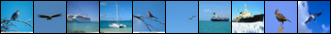

Train accuracy of car = 46.62%
Hard negatives for car


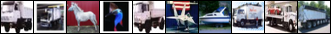

Train accuracy of bird = 17.94%
Hard negatives for bird


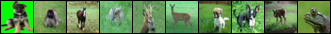

Train accuracy of cat = 12.72%
Hard negatives for cat


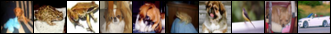

Train accuracy of deer = 35.18%
Hard negatives for deer


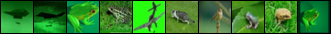

Train accuracy of dog = 37.98%
Hard negatives for dog


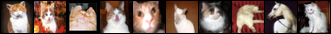

Train accuracy of frog = 55.66%
Hard negatives for frog


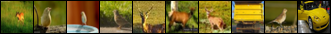

Train accuracy of horse = 39.86%
Hard negatives for horse


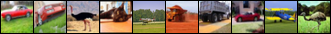

Train accuracy of ship = 49.88%
Hard negatives for ship


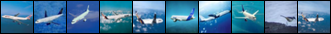

Train accuracy of truck = 48.06%
Hard negatives for truck


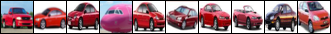


Test accuracy of the network: 39.44%
Test accuracy of plane = 47.50%
Hard negatives for plane


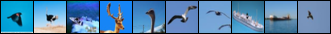

Test accuracy of car = 48.70%
Hard negatives for car


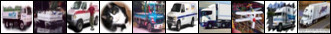

Test accuracy of bird = 18.50%
Hard negatives for bird


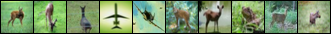

Test accuracy of cat = 11.70%
Hard negatives for cat


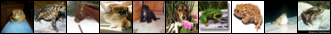

Test accuracy of deer = 33.70%
Hard negatives for deer


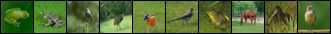

Test accuracy of dog = 37.30%
Hard negatives for dog


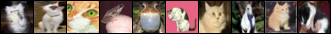

Test accuracy of frog = 58.10%
Hard negatives for frog


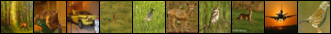

Test accuracy of horse = 42.30%
Hard negatives for horse


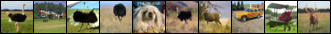

Test accuracy of ship = 50.20%
Hard negatives for ship


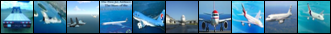

Test accuracy of truck = 46.40%
Hard negatives for truck


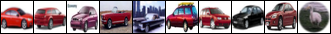


Epoch 10 summary -- loss = 1.723



Epoch 11 summary -- loss = 1.695



Epoch 12 summary -- loss = 1.672



Epoch 13 summary -- loss = 1.650



Epoch 14 summary -- loss = 1.631



Epoch 15 summary -- loss = 1.612



Epoch 16 summary -- loss = 1.596



Epoch 17 summary -- loss = 1.580



Epoch 18 summary -- loss = 1.566



Epoch 19 summary -- loss = 1.552
Evaluating epoch 20



Train accuracy of the network: 45.05%
Train accuracy of plane = 47.48%
Hard negatives for plane


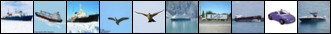

Train accuracy of car = 58.48%
Hard negatives for car


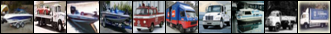

Train accuracy of bird = 30.74%
Hard negatives for bird


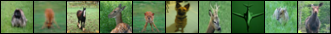

Train accuracy of cat = 25.02%
Hard negatives for cat


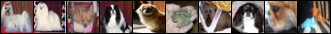

Train accuracy of deer = 35.92%
Hard negatives for deer


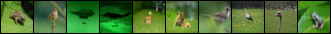

Train accuracy of dog = 39.68%
Hard negatives for dog


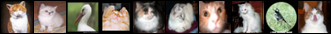

Train accuracy of frog = 53.12%
Hard negatives for frog


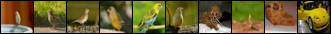

Train accuracy of horse = 49.16%
Hard negatives for horse


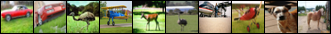

Train accuracy of ship = 57.86%
Hard negatives for ship


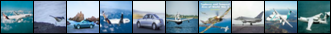

Train accuracy of truck = 53.08%
Hard negatives for truck


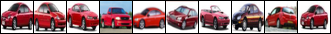


Test accuracy of the network: 44.83%
Test accuracy of plane = 47.40%
Hard negatives for plane


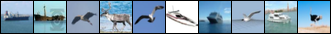

Test accuracy of car = 59.40%
Hard negatives for car


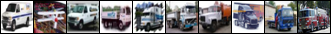

Test accuracy of bird = 30.70%
Hard negatives for bird


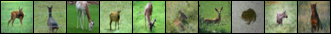

Test accuracy of cat = 22.80%
Hard negatives for cat


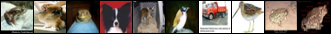

Test accuracy of deer = 36.00%
Hard negatives for deer


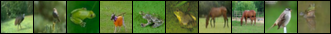

Test accuracy of dog = 38.50%
Hard negatives for dog


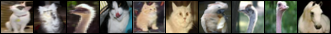

Test accuracy of frog = 55.90%
Hard negatives for frog


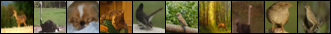

Test accuracy of horse = 49.60%
Hard negatives for horse


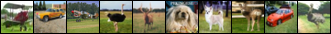

Test accuracy of ship = 57.30%
Hard negatives for ship


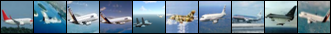

Test accuracy of truck = 50.70%
Hard negatives for truck


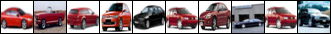


Epoch 20 summary -- loss = 1.539



Epoch 21 summary -- loss = 1.528



Epoch 22 summary -- loss = 1.516



Epoch 23 summary -- loss = 1.506



Epoch 24 summary -- loss = 1.495



Epoch 25 summary -- loss = 1.484



Epoch 26 summary -- loss = 1.475



Epoch 27 summary -- loss = 1.465



Epoch 28 summary -- loss = 1.454



Epoch 29 summary -- loss = 1.445
Evaluating epoch 30



Train accuracy of the network: 48.78%
Train accuracy of plane = 51.50%
Hard negatives for plane


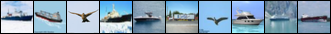

Train accuracy of car = 61.90%
Hard negatives for car


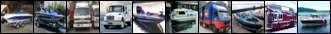

Train accuracy of bird = 36.78%
Hard negatives for bird


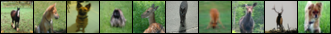

Train accuracy of cat = 30.94%
Hard negatives for cat


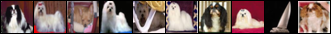

Train accuracy of deer = 39.62%
Hard negatives for deer


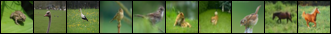

Train accuracy of dog = 41.46%
Hard negatives for dog


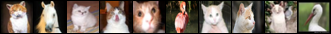

Train accuracy of frog = 57.72%
Hard negatives for frog


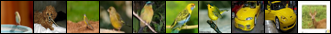

Train accuracy of horse = 52.12%
Hard negatives for horse


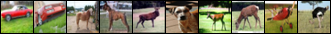

Train accuracy of ship = 60.92%
Hard negatives for ship


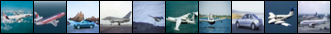

Train accuracy of truck = 54.80%
Hard negatives for truck


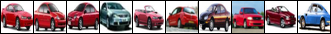


Test accuracy of the network: 48.72%
Test accuracy of plane = 52.00%
Hard negatives for plane


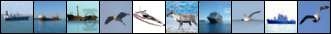

Test accuracy of car = 62.90%
Hard negatives for car


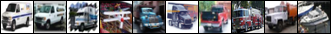

Test accuracy of bird = 35.50%
Hard negatives for bird


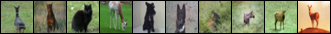

Test accuracy of cat = 30.10%
Hard negatives for cat


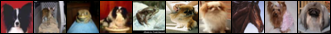

Test accuracy of deer = 39.10%
Hard negatives for deer


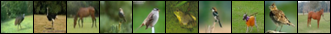

Test accuracy of dog = 39.90%
Hard negatives for dog


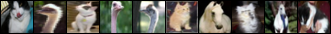

Test accuracy of frog = 60.50%
Hard negatives for frog


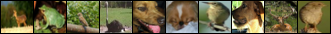

Test accuracy of horse = 53.20%
Hard negatives for horse


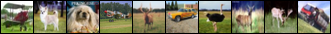

Test accuracy of ship = 61.70%
Hard negatives for ship


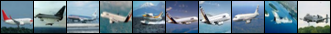

Test accuracy of truck = 52.30%
Hard negatives for truck


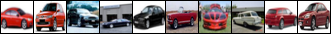

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 2.293



Epoch 1 summary -- loss = 2.258



Epoch 2 summary -- loss = 2.214



Epoch 3 summary -- loss = 2.170



Epoch 4 summary -- loss = 2.134



Epoch 5 summary -- loss = 2.105



Epoch 6 summary -- loss = 2.082



Epoch 7 summary -- loss = 2.061



Epoch 8 summary -- loss = 2.044



Epoch 9 summary -- loss = 2.026
Evaluating epoch 10



Train accuracy of the network: 27.66%
Train accuracy of plane = 45.50%
Hard negatives for plane


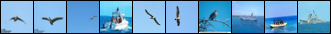

Train accuracy of car = 23.48%
Hard negatives for car


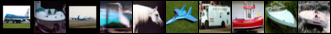

Train accuracy of bird = 2.38%
Hard negatives for bird


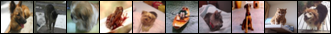

Train accuracy of cat = 10.98%
Hard negatives for cat


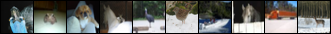

Train accuracy of deer = 2.46%
Hard negatives for deer


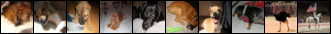

Train accuracy of dog = 25.66%
Hard negatives for dog


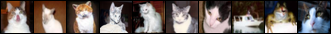

Train accuracy of frog = 63.82%
Hard negatives for frog


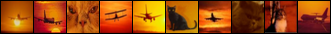

Train accuracy of horse = 15.14%
Hard negatives for horse


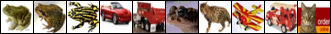

Train accuracy of ship = 41.64%
Hard negatives for ship


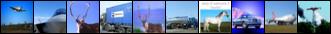

Train accuracy of truck = 45.56%
Hard negatives for truck


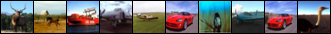


Test accuracy of the network: 28.33%
Test accuracy of plane = 48.10%
Hard negatives for plane


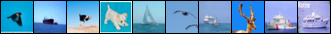

Test accuracy of car = 26.20%
Hard negatives for car


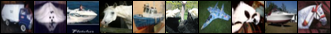

Test accuracy of bird = 2.30%
Hard negatives for bird


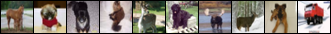

Test accuracy of cat = 10.40%
Hard negatives for cat


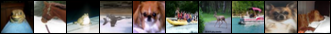

Test accuracy of deer = 2.60%
Hard negatives for deer


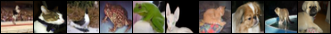

Test accuracy of dog = 25.40%
Hard negatives for dog


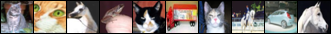

Test accuracy of frog = 63.50%
Hard negatives for frog


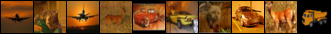

Test accuracy of horse = 16.80%
Hard negatives for horse


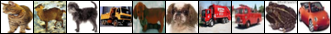

Test accuracy of ship = 41.40%
Hard negatives for ship


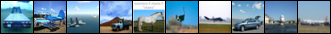

Test accuracy of truck = 46.60%
Hard negatives for truck


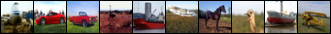


Epoch 10 summary -- loss = 2.011



Epoch 11 summary -- loss = 1.995



Epoch 12 summary -- loss = 1.982



Epoch 13 summary -- loss = 1.969



Epoch 14 summary -- loss = 1.957



Epoch 15 summary -- loss = 1.945



Epoch 16 summary -- loss = 1.935



Epoch 17 summary -- loss = 1.924



Epoch 18 summary -- loss = 1.914



Epoch 19 summary -- loss = 1.905
Evaluating epoch 20



Train accuracy of the network: 32.35%
Train accuracy of plane = 43.48%
Hard negatives for plane


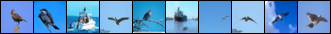

Train accuracy of car = 37.42%
Hard negatives for car


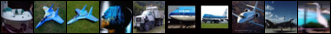

Train accuracy of bird = 9.22%
Hard negatives for bird


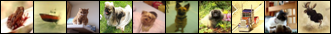

Train accuracy of cat = 11.82%
Hard negatives for cat


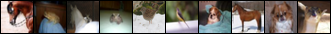

Train accuracy of deer = 10.60%
Hard negatives for deer


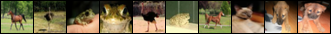

Train accuracy of dog = 37.04%
Hard negatives for dog


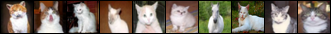

Train accuracy of frog = 57.80%
Hard negatives for frog


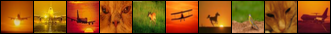

Train accuracy of horse = 28.10%
Hard negatives for horse


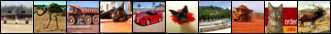

Train accuracy of ship = 44.70%
Hard negatives for ship


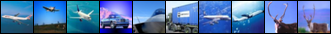

Train accuracy of truck = 43.34%
Hard negatives for truck


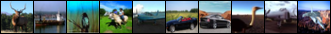


Test accuracy of the network: 33.20%
Test accuracy of plane = 45.80%
Hard negatives for plane


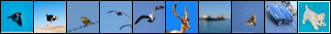

Test accuracy of car = 38.40%
Hard negatives for car


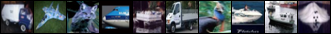

Test accuracy of bird = 10.80%
Hard negatives for bird


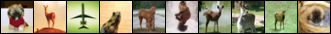

Test accuracy of cat = 11.30%
Hard negatives for cat


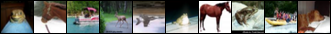

Test accuracy of deer = 9.30%
Hard negatives for deer


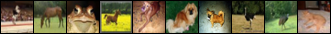

Test accuracy of dog = 37.50%
Hard negatives for dog


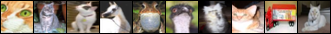

Test accuracy of frog = 60.30%
Hard negatives for frog


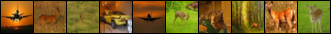

Test accuracy of horse = 30.50%
Hard negatives for horse


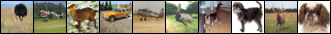

Test accuracy of ship = 45.10%
Hard negatives for ship


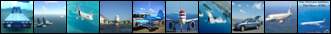

Test accuracy of truck = 43.00%
Hard negatives for truck


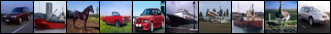


Epoch 20 summary -- loss = 1.894



Epoch 21 summary -- loss = 1.886



Epoch 22 summary -- loss = 1.874



Epoch 23 summary -- loss = 1.865



Epoch 24 summary -- loss = 1.853



Epoch 25 summary -- loss = 1.843



Epoch 26 summary -- loss = 1.830



Epoch 27 summary -- loss = 1.818



Epoch 28 summary -- loss = 1.804



Epoch 29 summary -- loss = 1.790
Evaluating epoch 30



Train accuracy of the network: 37.66%
Train accuracy of plane = 45.52%
Hard negatives for plane


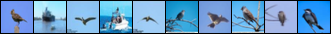

Train accuracy of car = 43.72%
Hard negatives for car


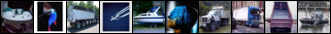

Train accuracy of bird = 15.54%
Hard negatives for bird


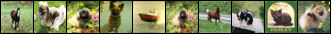

Train accuracy of cat = 15.80%
Hard negatives for cat


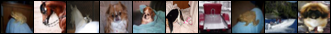

Train accuracy of deer = 29.14%
Hard negatives for deer


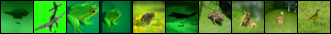

Train accuracy of dog = 37.30%
Hard negatives for dog


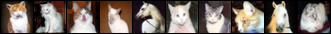

Train accuracy of frog = 56.18%
Hard negatives for frog


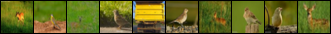

Train accuracy of horse = 38.34%
Hard negatives for horse


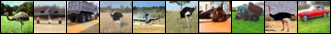

Train accuracy of ship = 47.84%
Hard negatives for ship


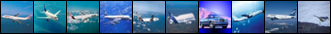

Train accuracy of truck = 47.18%
Hard negatives for truck


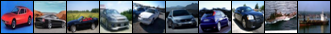


Test accuracy of the network: 38.54%
Test accuracy of plane = 47.60%
Hard negatives for plane


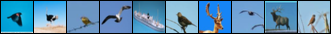

Test accuracy of car = 45.20%
Hard negatives for car


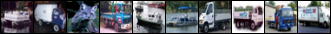

Test accuracy of bird = 15.60%
Hard negatives for bird


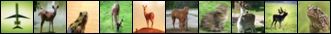

Test accuracy of cat = 16.10%
Hard negatives for cat


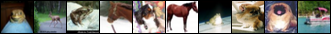

Test accuracy of deer = 28.50%
Hard negatives for deer


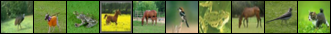

Test accuracy of dog = 36.90%
Hard negatives for dog


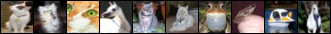

Test accuracy of frog = 59.40%
Hard negatives for frog


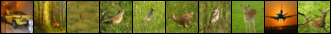

Test accuracy of horse = 41.20%
Hard negatives for horse


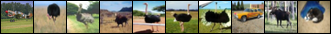

Test accuracy of ship = 48.50%
Hard negatives for ship


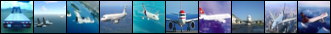

Test accuracy of truck = 46.40%
Hard negatives for truck


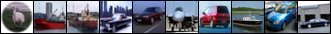

'\nplot_results(train_losses1, train_accuracies1, test_accuracies1)\nplot_results(train_losses, train_accuracies, test_accuracies)\nplot_results(train_losses2, train_accuracies2, test_accuracies2)\n\nprint("batch_size = 512")\nprint("train_loss: ",train_losses1[-1])\nprint("train_accuracies: ",train_accuracies1[-1])\nprint("test_accuracies: ",test_accuracies1[-1])\n\nprint("batch_size = 1024")\nprint("train_loss: ",train_losses[-1])\nprint("train_accuracies: ",train_accuracies[-1])\nprint("test_accuracies: ",test_accuracies[-1])\n\nprint("batch_size = 1500")\nprint("train_loss: ",train_losses2[-1])\nprint("train_accuracies: ",train_accuracies2[-1])\nprint("test_accuracies: ",test_accuracies2[-1])\n'

In [0]:
net1 = CoolNet()

# TODO: Your code here
train_losses1, train_accuracies1, test_accuracies1 = train_network(
    net1, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=512)

net2 = CoolNet()
train_losses2, train_accuracies2, test_accuracies2 = train_network(
    net2, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=1500)


Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 2.224



Epoch 1 summary -- loss = 2.074



Epoch 2 summary -- loss = 1.992



Epoch 3 summary -- loss = 1.931



Epoch 4 summary -- loss = 1.878



Epoch 5 summary -- loss = 1.823



Epoch 6 summary -- loss = 1.763



Epoch 7 summary -- loss = 1.709



Epoch 8 summary -- loss = 1.670



Epoch 9 summary -- loss = 1.637
Evaluating epoch 10



Train accuracy of the network: 42.93%
Train accuracy of plane = 47.30%
Hard negatives for plane


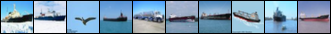

Train accuracy of car = 54.70%
Hard negatives for car


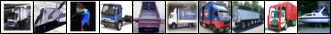

Train accuracy of bird = 28.50%
Hard negatives for bird


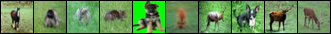

Train accuracy of cat = 20.20%
Hard negatives for cat


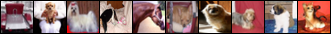

Train accuracy of deer = 33.76%
Hard negatives for deer


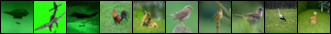

Train accuracy of dog = 34.44%
Hard negatives for dog


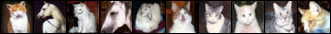

Train accuracy of frog = 56.34%
Hard negatives for frog


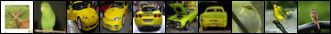

Train accuracy of horse = 48.68%
Hard negatives for horse


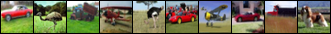

Train accuracy of ship = 56.06%
Hard negatives for ship


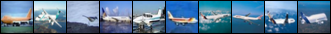

Train accuracy of truck = 49.28%
Hard negatives for truck


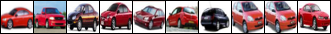


Test accuracy of the network: 42.73%
Test accuracy of plane = 48.00%
Hard negatives for plane


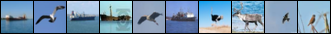

Test accuracy of car = 56.20%
Hard negatives for car


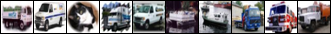

Test accuracy of bird = 27.60%
Hard negatives for bird


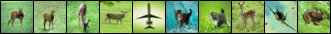

Test accuracy of cat = 19.10%
Hard negatives for cat


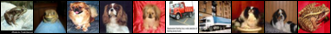

Test accuracy of deer = 32.70%
Hard negatives for deer


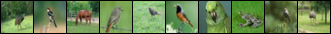

Test accuracy of dog = 32.80%
Hard negatives for dog


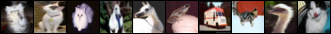

Test accuracy of frog = 59.20%
Hard negatives for frog


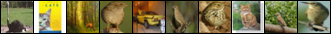

Test accuracy of horse = 49.10%
Hard negatives for horse


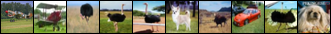

Test accuracy of ship = 55.00%
Hard negatives for ship


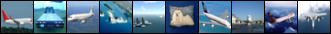

Test accuracy of truck = 47.60%
Hard negatives for truck


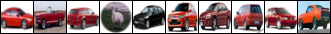


Epoch 10 summary -- loss = 1.606



Epoch 11 summary -- loss = 1.579



Epoch 12 summary -- loss = 1.555



Epoch 13 summary -- loss = 1.535



Epoch 14 summary -- loss = 1.517



Epoch 15 summary -- loss = 1.502



Epoch 16 summary -- loss = 1.489



Epoch 17 summary -- loss = 1.477



Epoch 18 summary -- loss = 1.465



Epoch 19 summary -- loss = 1.455
Evaluating epoch 20



Train accuracy of the network: 48.59%
Train accuracy of plane = 50.92%
Hard negatives for plane


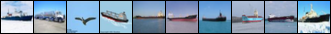

Train accuracy of car = 62.18%
Hard negatives for car


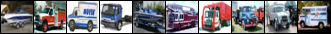

Train accuracy of bird = 34.56%
Hard negatives for bird


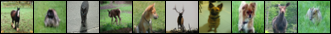

Train accuracy of cat = 34.74%
Hard negatives for cat


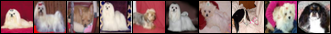

Train accuracy of deer = 37.04%
Hard negatives for deer


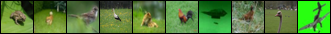

Train accuracy of dog = 40.80%
Hard negatives for dog


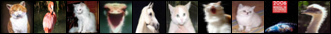

Train accuracy of frog = 58.48%
Hard negatives for frog


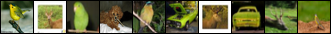

Train accuracy of horse = 54.06%
Hard negatives for horse


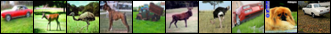

Train accuracy of ship = 59.00%
Hard negatives for ship


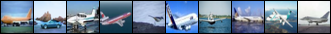

Train accuracy of truck = 54.10%
Hard negatives for truck


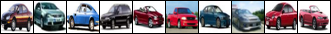


Test accuracy of the network: 48.71%
Test accuracy of plane = 51.60%
Hard negatives for plane


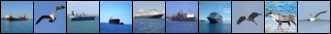

Test accuracy of car = 63.20%
Hard negatives for car


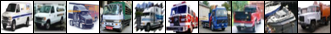

Test accuracy of bird = 33.80%
Hard negatives for bird


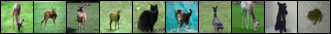

Test accuracy of cat = 36.20%
Hard negatives for cat


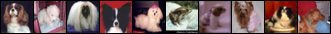

Test accuracy of deer = 36.90%
Hard negatives for deer


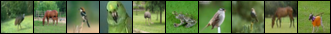

Test accuracy of dog = 39.20%
Hard negatives for dog


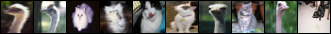

Test accuracy of frog = 61.10%
Hard negatives for frog


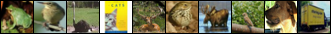

Test accuracy of horse = 55.50%
Hard negatives for horse


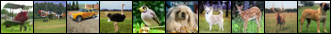

Test accuracy of ship = 57.80%
Hard negatives for ship


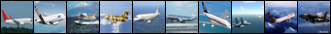

Test accuracy of truck = 51.80%
Hard negatives for truck


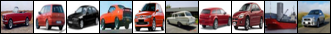


Epoch 20 summary -- loss = 1.444



Epoch 21 summary -- loss = 1.434



Epoch 22 summary -- loss = 1.424



Epoch 23 summary -- loss = 1.413



Epoch 24 summary -- loss = 1.402



Epoch 25 summary -- loss = 1.390



Epoch 26 summary -- loss = 1.380



Epoch 27 summary -- loss = 1.367



Epoch 28 summary -- loss = 1.355



Epoch 29 summary -- loss = 1.343
Evaluating epoch 30



Train accuracy of the network: 52.37%
Train accuracy of plane = 54.40%
Hard negatives for plane


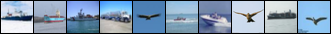

Train accuracy of car = 64.20%
Hard negatives for car


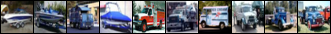

Train accuracy of bird = 36.24%
Hard negatives for bird


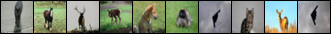

Train accuracy of cat = 35.26%
Hard negatives for cat


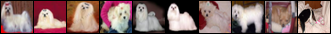

Train accuracy of deer = 40.88%
Hard negatives for deer


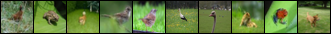

Train accuracy of dog = 40.90%
Hard negatives for dog


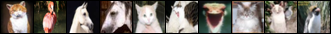

Train accuracy of frog = 68.22%
Hard negatives for frog


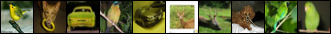

Train accuracy of horse = 58.20%
Hard negatives for horse


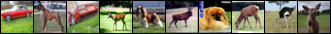

Train accuracy of ship = 67.88%
Hard negatives for ship


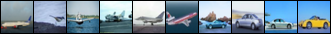

Train accuracy of truck = 57.48%
Hard negatives for truck


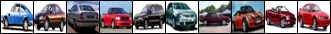


Test accuracy of the network: 52.16%
Test accuracy of plane = 56.60%
Hard negatives for plane


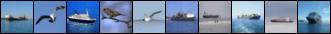

Test accuracy of car = 63.90%
Hard negatives for car


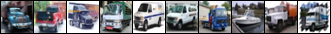

Test accuracy of bird = 35.20%
Hard negatives for bird


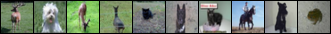

Test accuracy of cat = 34.80%
Hard negatives for cat


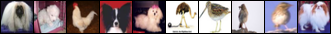

Test accuracy of deer = 40.60%
Hard negatives for deer


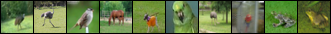

Test accuracy of dog = 40.20%
Hard negatives for dog


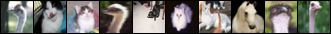

Test accuracy of frog = 70.50%
Hard negatives for frog


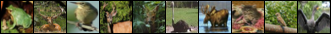

Test accuracy of horse = 58.70%
Hard negatives for horse


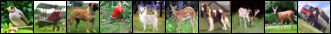

Test accuracy of ship = 67.20%
Hard negatives for ship


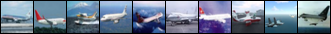

Test accuracy of truck = 53.90%
Hard negatives for truck


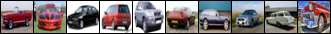

In [44]:
net3 = CoolNet()
train_losses3, train_accuracies3, test_accuracies3 = train_network(
    net3, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=30, 
    batch_size=300)

batch_size = 512
train_loss:  1.4454228026526315
train_accuracies:  0.48776
test_accuracies:  0.4872
batch_size = 1024
train_loss:  1.7004464183534895
train_accuracies:  0.40492
test_accuracies:  0.4062
batch_size = 1500
train_loss:  1.7899425380370195
train_accuracies:  0.37656
test_accuracies:  0.3854


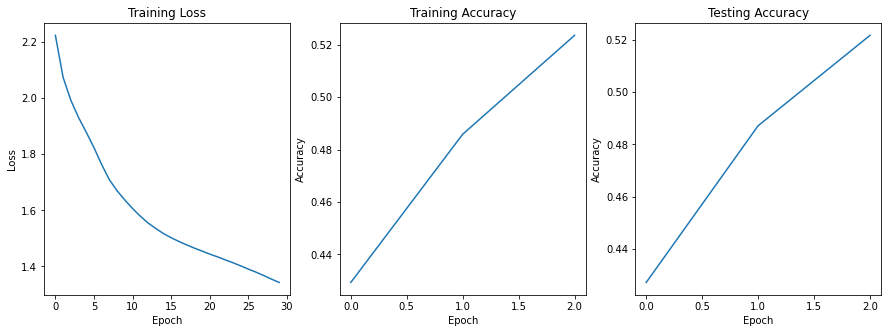

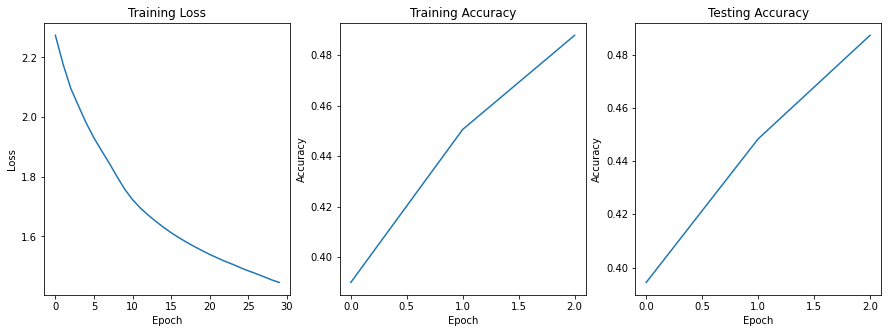

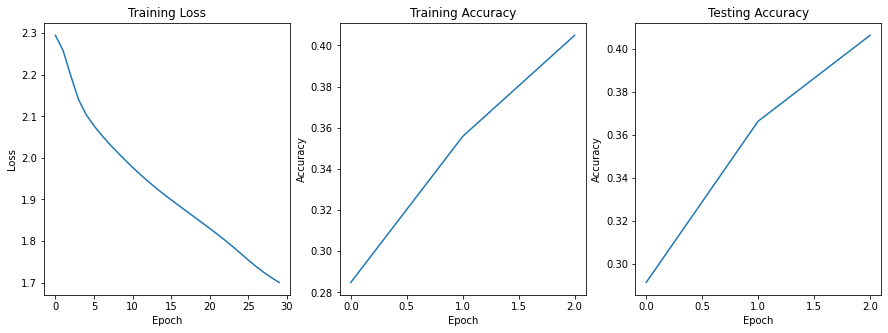

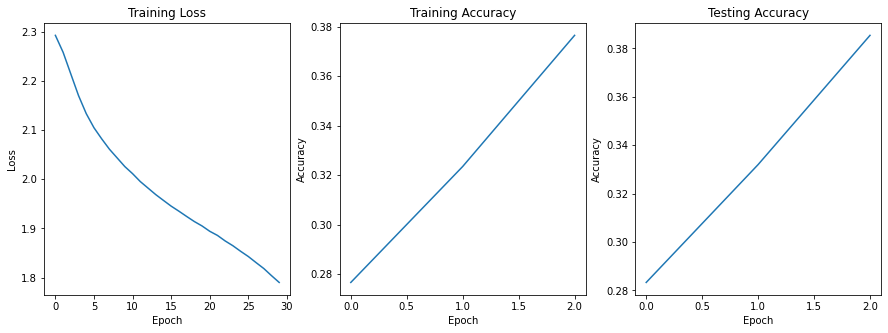

In [47]:
plot_results(train_losses3, train_accuracies3, test_accuracies3)
plot_results(train_losses1, train_accuracies1, test_accuracies1)
plot_results(train_losses, train_accuracies, test_accuracies)
plot_results(train_losses2, train_accuracies2, test_accuracies2)

print("batch_size = 512")
print("train_loss: ",train_losses1[-1])
print("train_accuracies: ",train_accuracies1[-1])
print("test_accuracies: ",test_accuracies1[-1])

print("batch_size = 1024")
print("train_loss: ",train_losses[-1])
print("train_accuracies: ",train_accuracies[-1])
print("test_accuracies: ",test_accuracies[-1])

print("batch_size = 1500")
print("train_loss: ",train_losses2[-1])
print("train_accuracies: ",train_accuracies2[-1])
print("test_accuracies: ",test_accuracies2[-1])



When lr = 0.01, epochs = 30
batch_size = 300
train_loss:  1.3429241937077687
train_accuracies:  0.52366
test_accuracies:  0.5216

batch_size = 512
train_loss:  1.4454228026526315
train_accuracies:  0.48776
test_accuracies:  0.4872

batch_size = 1024
train_loss:  1.7004464183534895
train_accuracies:  0.40492
test_accuracies:  0.4062

batch_size = 1500
train_loss:  1.7899425380370195
train_accuracies:  0.37656
test_accuracies:  0.3854

According to the experiment results, when batch size becomes larger, train loss will be higher, train accuracy and test accuracy will be lower. It's because smaller batch size means loading less data at a time and updating more, which leading to faster converge.

### 2.3.2. How does learning rate work?

When you are trying to train a neural network it is really hard to choose a proper learning rate. 

Try to train your model with different learning rates and plot the training accuracy, test accuracy and loss and compare the training progress for learning rates = 10, 0.1, 0.01, 0.0001.

Analyze the results and choose the best one. Why did you choose this value?




Epoch 11 summary -- loss = 17.288



Epoch 12 summary -- loss = 15.780



Epoch 13 summary -- loss = 17.760



Epoch 14 summary -- loss = 15.375



Epoch 15 summary -- loss = 15.730



Epoch 16 summary -- loss = 15.770



Epoch 17 summary -- loss = 15.630



Epoch 18 summary -- loss = 14.181



Epoch 19 summary -- loss = 13.656
Evaluating epoch 20



Train accuracy of the network: 20.25%
Train accuracy of plane = 37.72%
Hard negatives for plane


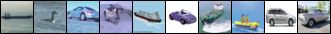

Train accuracy of car = 31.70%
Hard negatives for car


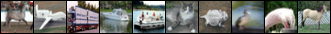

Train accuracy of bird = 19.00%
Hard negatives for bird


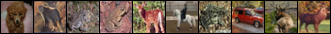

Train accuracy of cat = 1.50%
Hard negatives for cat


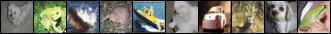

Train accuracy of deer = 13.88%
Hard negatives for deer


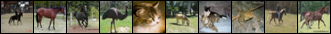

Train accuracy of dog = 17.02%
Hard negatives for dog


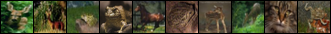

Train accuracy of frog = 14.56%
Hard negatives for frog


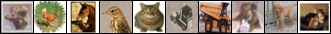

Train accuracy of horse = 31.64%
Hard negatives for horse


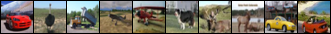

Train accuracy of ship = 30.06%
Hard negatives for ship


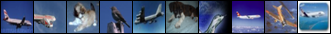

Train accuracy of truck = 5.46%
Hard negatives for truck


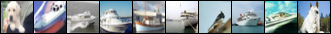


Test accuracy of the network: 19.75%
Test accuracy of plane = 36.70%
Hard negatives for plane


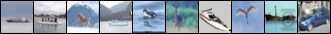

Test accuracy of car = 33.00%
Hard negatives for car


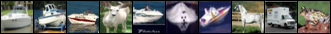

Test accuracy of bird = 19.90%
Hard negatives for bird


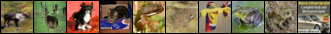

Test accuracy of cat = 1.70%
Hard negatives for cat


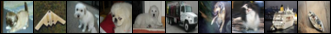

Test accuracy of deer = 13.20%
Hard negatives for deer


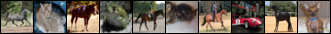

Test accuracy of dog = 14.20%
Hard negatives for dog


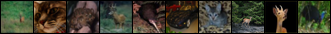

Test accuracy of frog = 13.40%
Hard negatives for frog


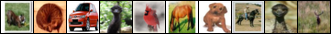

Test accuracy of horse = 31.70%
Hard negatives for horse


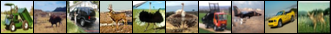

Test accuracy of ship = 28.20%
Hard negatives for ship


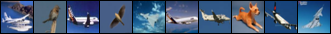

Test accuracy of truck = 5.50%
Hard negatives for truck


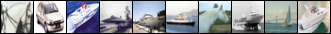


Epoch 20 summary -- loss = 13.079



Epoch 21 summary -- loss = 12.622



Epoch 22 summary -- loss = 11.836



Epoch 23 summary -- loss = 11.633



Epoch 24 summary -- loss = 10.963



Epoch 25 summary -- loss = 11.436



Epoch 26 summary -- loss = 11.585



Epoch 27 summary -- loss = 11.354



Epoch 28 summary -- loss = 11.113



Epoch 29 summary -- loss = 10.739
Evaluating epoch 30



Train accuracy of the network: 22.73%
Train accuracy of plane = 12.96%
Hard negatives for plane


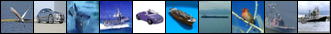

Train accuracy of car = 16.72%
Hard negatives for car


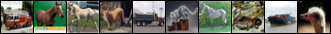

Train accuracy of bird = 12.22%
Hard negatives for bird


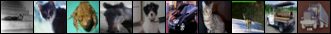

Train accuracy of cat = 14.62%
Hard negatives for cat


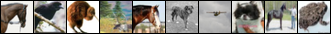

Train accuracy of deer = 7.44%
Hard negatives for deer


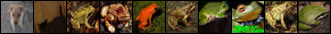

Train accuracy of dog = 42.58%
Hard negatives for dog


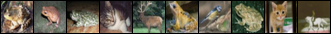

Train accuracy of frog = 11.26%
Hard negatives for frog


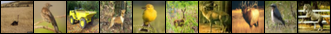

Train accuracy of horse = 31.54%
Hard negatives for horse


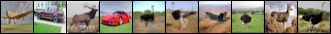

Train accuracy of ship = 41.62%
Hard negatives for ship


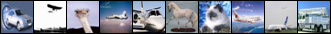

Train accuracy of truck = 36.36%
Hard negatives for truck


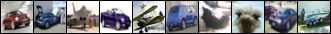


Test accuracy of the network: 22.69%
Test accuracy of plane = 10.50%
Hard negatives for plane


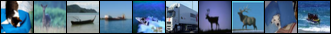

Test accuracy of car = 18.30%
Hard negatives for car


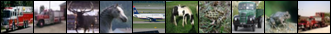

Test accuracy of bird = 13.70%
Hard negatives for bird


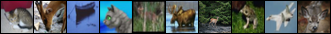

Test accuracy of cat = 14.90%
Hard negatives for cat


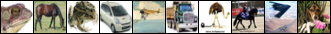

Test accuracy of deer = 7.50%
Hard negatives for deer


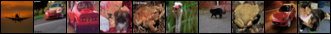

Test accuracy of dog = 39.00%
Hard negatives for dog


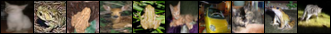

Test accuracy of frog = 11.60%
Hard negatives for frog


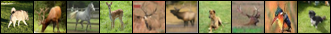

Test accuracy of horse = 31.40%
Hard negatives for horse


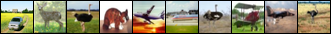

Test accuracy of ship = 42.80%
Hard negatives for ship


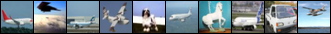

Test accuracy of truck = 37.20%
Hard negatives for truck


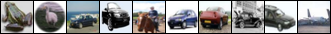

In [48]:
net = CoolNet()
# TODO: Your code here
train_losses1, train_accuracies1, test_accuracies1 = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=10, 
    epochs=30, 
    batch_size=300)



In [50]:
print("lr = 10")
print("train_loss: ",train_losses1[-1])
print("train_accuracies: ",train_accuracies1[-1])
print("test_accuracies: ",test_accuracies1[-1])

lr = 10
train_loss:  10.739156437491229
train_accuracies:  0.22732
test_accuracies:  0.2269


Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 5.466



Epoch 1 summary -- loss = 3.023



Epoch 2 summary -- loss = 2.467



Epoch 3 summary -- loss = 2.168



Epoch 4 summary -- loss = 2.005



Epoch 5 summary -- loss = 1.921



Epoch 6 summary -- loss = 1.877



Epoch 7 summary -- loss = 1.853



Epoch 8 summary -- loss = 1.841



Epoch 9 summary -- loss = 1.833
Evaluating epoch 10



Train accuracy of the network: 35.65%
Train accuracy of plane = 45.16%
Hard negatives for plane


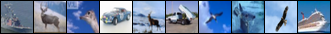

Train accuracy of car = 37.56%
Hard negatives for car


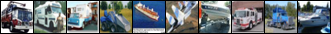

Train accuracy of bird = 20.80%
Hard negatives for bird


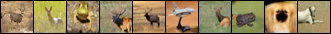

Train accuracy of cat = 19.58%
Hard negatives for cat


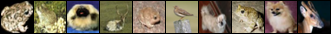

Train accuracy of deer = 27.88%
Hard negatives for deer


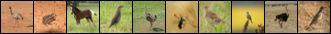

Train accuracy of dog = 32.18%
Hard negatives for dog


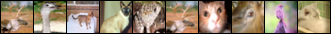

Train accuracy of frog = 42.54%
Hard negatives for frog


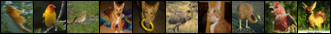

Train accuracy of horse = 35.82%
Hard negatives for horse


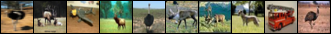

Train accuracy of ship = 53.64%
Hard negatives for ship


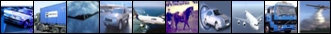

Train accuracy of truck = 41.32%
Hard negatives for truck


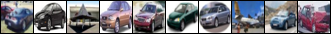


Test accuracy of the network: 34.35%
Test accuracy of plane = 47.60%
Hard negatives for plane


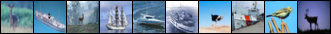

Test accuracy of car = 35.80%
Hard negatives for car


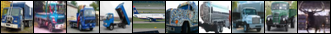

Test accuracy of bird = 17.90%
Hard negatives for bird


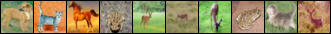

Test accuracy of cat = 18.00%
Hard negatives for cat


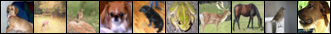

Test accuracy of deer = 27.30%
Hard negatives for deer


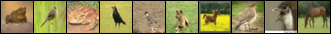

Test accuracy of dog = 30.90%
Hard negatives for dog


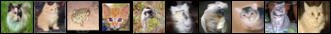

Test accuracy of frog = 41.50%
Hard negatives for frog


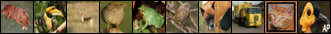

Test accuracy of horse = 34.90%
Hard negatives for horse


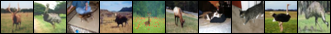

Test accuracy of ship = 51.00%
Hard negatives for ship


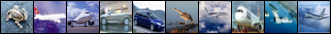

Test accuracy of truck = 38.60%
Hard negatives for truck


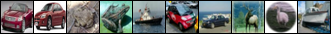


Epoch 10 summary -- loss = 1.828



Epoch 11 summary -- loss = 1.825



Epoch 12 summary -- loss = 1.822



Epoch 13 summary -- loss = 1.820



Epoch 14 summary -- loss = 1.819



Epoch 15 summary -- loss = 1.818



Epoch 16 summary -- loss = 1.817



Epoch 17 summary -- loss = 1.815



Epoch 18 summary -- loss = 1.815



Epoch 19 summary -- loss = 1.814
Evaluating epoch 20



Train accuracy of the network: 35.77%
Train accuracy of plane = 47.46%
Hard negatives for plane


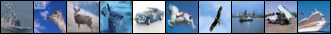

Train accuracy of car = 38.88%
Hard negatives for car


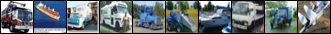

Train accuracy of bird = 20.02%
Hard negatives for bird


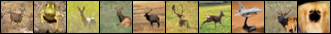

Train accuracy of cat = 16.62%
Hard negatives for cat


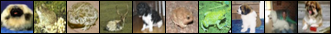

Train accuracy of deer = 25.74%
Hard negatives for deer


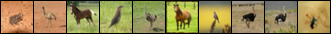

Train accuracy of dog = 36.38%
Hard negatives for dog


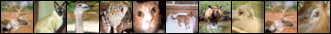

Train accuracy of frog = 42.80%
Hard negatives for frog


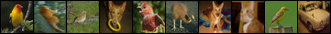

Train accuracy of horse = 36.26%
Hard negatives for horse


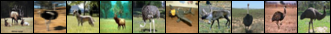

Train accuracy of ship = 50.44%
Hard negatives for ship


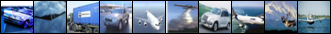

Train accuracy of truck = 43.12%
Hard negatives for truck


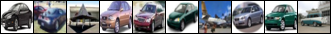


Test accuracy of the network: 34.55%
Test accuracy of plane = 49.70%
Hard negatives for plane


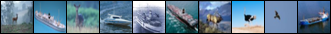

Test accuracy of car = 37.20%
Hard negatives for car


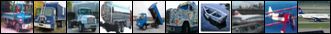

Test accuracy of bird = 18.80%
Hard negatives for bird


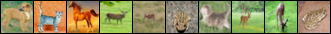

Test accuracy of cat = 15.20%
Hard negatives for cat


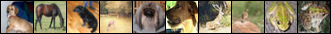

Test accuracy of deer = 24.80%
Hard negatives for deer


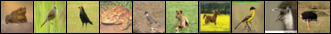

Test accuracy of dog = 33.80%
Hard negatives for dog


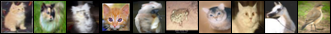

Test accuracy of frog = 40.50%
Hard negatives for frog


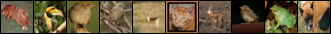

Test accuracy of horse = 33.70%
Hard negatives for horse


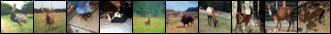

Test accuracy of ship = 50.00%
Hard negatives for ship


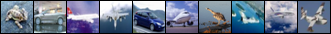

Test accuracy of truck = 41.80%
Hard negatives for truck


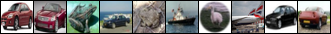


Epoch 20 summary -- loss = 1.814



Epoch 21 summary -- loss = 1.813



Epoch 22 summary -- loss = 1.812



Epoch 23 summary -- loss = 1.812



Epoch 24 summary -- loss = 1.811



Epoch 25 summary -- loss = 1.811



Epoch 26 summary -- loss = 1.810



Epoch 27 summary -- loss = 1.810



Epoch 28 summary -- loss = 1.810



Epoch 29 summary -- loss = 1.809
Evaluating epoch 30



Train accuracy of the network: 36.13%
Train accuracy of plane = 46.36%
Hard negatives for plane


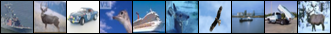

Train accuracy of car = 39.84%
Hard negatives for car


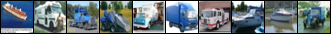

Train accuracy of bird = 21.34%
Hard negatives for bird


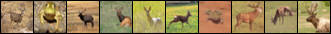

Train accuracy of cat = 20.34%
Hard negatives for cat


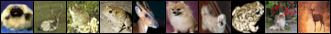

Train accuracy of deer = 22.24%
Hard negatives for deer


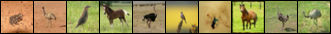

Train accuracy of dog = 30.28%
Hard negatives for dog


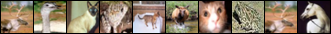

Train accuracy of frog = 46.44%
Hard negatives for frog


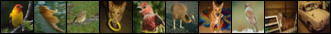

Train accuracy of horse = 38.32%
Hard negatives for horse


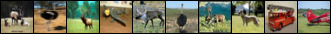

Train accuracy of ship = 53.48%
Hard negatives for ship


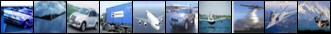

Train accuracy of truck = 42.64%
Hard negatives for truck


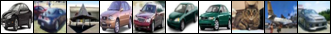


Test accuracy of the network: 34.55%
Test accuracy of plane = 48.20%
Hard negatives for plane


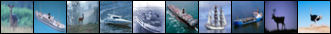

Test accuracy of car = 37.40%
Hard negatives for car


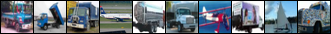

Test accuracy of bird = 18.80%
Hard negatives for bird


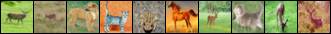

Test accuracy of cat = 18.00%
Hard negatives for cat


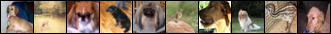

Test accuracy of deer = 20.60%
Hard negatives for deer


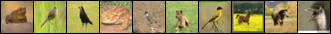

Test accuracy of dog = 29.30%
Hard negatives for dog


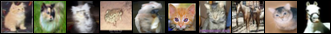

Test accuracy of frog = 44.60%
Hard negatives for frog


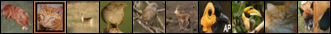

Test accuracy of horse = 36.00%
Hard negatives for horse


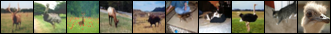

Test accuracy of ship = 52.60%
Hard negatives for ship


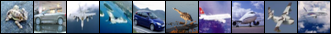

Test accuracy of truck = 40.00%
Hard negatives for truck


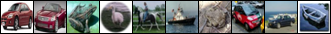

Files already downloaded and verified
Files already downloaded and verified



Epoch 0 summary -- loss = 1.801



Epoch 1 summary -- loss = 1.801



Epoch 2 summary -- loss = 1.801



Epoch 3 summary -- loss = 1.801



Epoch 4 summary -- loss = 1.801



Epoch 5 summary -- loss = 1.801



Epoch 6 summary -- loss = 1.801



Epoch 7 summary -- loss = 1.801



Epoch 8 summary -- loss = 1.801



Epoch 9 summary -- loss = 1.800
Evaluating epoch 10



Train accuracy of the network: 36.15%
Train accuracy of plane = 46.24%
Hard negatives for plane


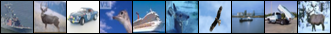

Train accuracy of car = 39.68%
Hard negatives for car


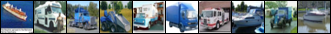

Train accuracy of bird = 21.00%
Hard negatives for bird


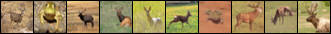

Train accuracy of cat = 19.86%
Hard negatives for cat


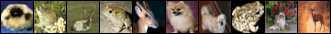

Train accuracy of deer = 23.02%
Hard negatives for deer


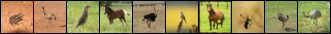

Train accuracy of dog = 31.22%
Hard negatives for dog


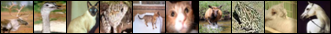

Train accuracy of frog = 46.18%
Hard negatives for frog


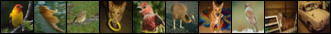

Train accuracy of horse = 38.02%
Hard negatives for horse


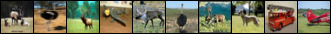

Train accuracy of ship = 53.54%
Hard negatives for ship


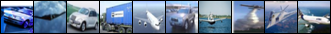

Train accuracy of truck = 42.74%
Hard negatives for truck


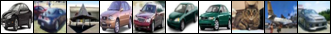


Test accuracy of the network: 34.57%
Test accuracy of plane = 48.40%
Hard negatives for plane


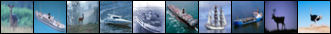

Test accuracy of car = 36.90%
Hard negatives for car


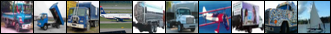

Test accuracy of bird = 18.50%
Hard negatives for bird


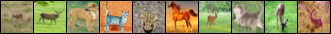

Test accuracy of cat = 17.80%
Hard negatives for cat


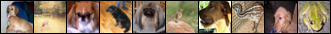

Test accuracy of deer = 21.50%
Hard negatives for deer


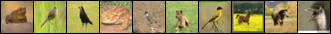

Test accuracy of dog = 29.80%
Hard negatives for dog


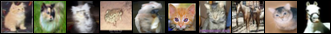

Test accuracy of frog = 44.10%
Hard negatives for frog


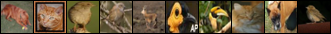

Test accuracy of horse = 35.40%
Hard negatives for horse


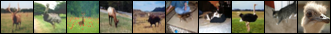

Test accuracy of ship = 52.70%
Hard negatives for ship


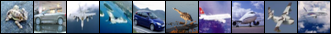

Test accuracy of truck = 40.60%
Hard negatives for truck


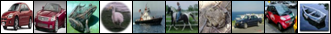


Epoch 10 summary -- loss = 1.800



Epoch 11 summary -- loss = 1.800



Epoch 12 summary -- loss = 1.800



Epoch 13 summary -- loss = 1.800



Epoch 14 summary -- loss = 1.800



Epoch 15 summary -- loss = 1.800



Epoch 16 summary -- loss = 1.800



Epoch 17 summary -- loss = 1.800



Epoch 18 summary -- loss = 1.800



Epoch 19 summary -- loss = 1.800
Evaluating epoch 20



Train accuracy of the network: 36.15%
Train accuracy of plane = 46.28%
Hard negatives for plane


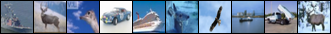

Train accuracy of car = 39.54%
Hard negatives for car


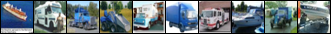

Train accuracy of bird = 20.60%
Hard negatives for bird


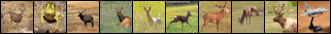

Train accuracy of cat = 19.42%
Hard negatives for cat


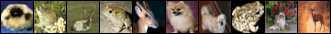

Train accuracy of deer = 23.58%
Hard negatives for deer


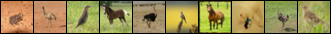

Train accuracy of dog = 31.64%
Hard negatives for dog


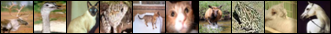

Train accuracy of frog = 46.00%
Hard negatives for frog


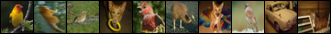

Train accuracy of horse = 37.88%
Hard negatives for horse


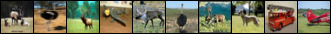

Train accuracy of ship = 53.56%
Hard negatives for ship


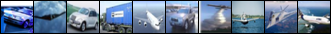

Train accuracy of truck = 43.04%
Hard negatives for truck


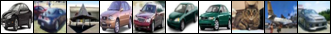


Test accuracy of the network: 34.58%
Test accuracy of plane = 48.40%
Hard negatives for plane


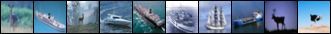

Test accuracy of car = 36.40%
Hard negatives for car


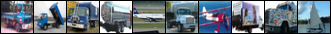

Test accuracy of bird = 18.10%
Hard negatives for bird


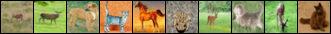

Test accuracy of cat = 17.70%
Hard negatives for cat


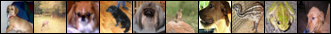

Test accuracy of deer = 22.40%
Hard negatives for deer


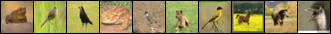

Test accuracy of dog = 30.40%
Hard negatives for dog


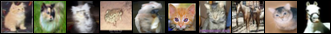

Test accuracy of frog = 43.80%
Hard negatives for frog


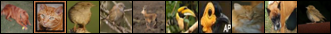

Test accuracy of horse = 35.10%
Hard negatives for horse


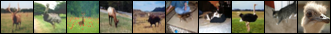

Test accuracy of ship = 52.60%
Hard negatives for ship


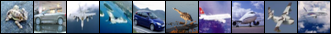

Test accuracy of truck = 40.90%
Hard negatives for truck


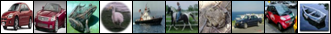


Epoch 20 summary -- loss = 1.800



Epoch 21 summary -- loss = 1.800



Epoch 22 summary -- loss = 1.800



Epoch 23 summary -- loss = 1.800



Epoch 24 summary -- loss = 1.800



Epoch 25 summary -- loss = 1.799



Epoch 26 summary -- loss = 1.799



Epoch 27 summary -- loss = 1.799



Epoch 28 summary -- loss = 1.800



Epoch 29 summary -- loss = 1.799
Evaluating epoch 30



Train accuracy of the network: 36.19%
Train accuracy of plane = 46.22%
Hard negatives for plane


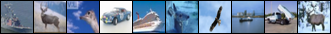

Train accuracy of car = 39.42%
Hard negatives for car


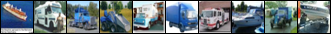

Train accuracy of bird = 20.24%
Hard negatives for bird


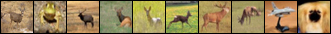

Train accuracy of cat = 19.28%
Hard negatives for cat


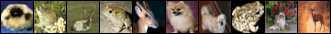

Train accuracy of deer = 24.16%
Hard negatives for deer


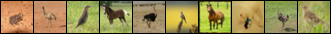

Train accuracy of dog = 32.04%
Hard negatives for dog


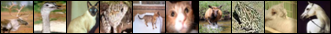

Train accuracy of frog = 46.00%
Hard negatives for frog


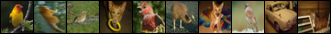

Train accuracy of horse = 37.74%
Hard negatives for horse


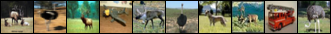

Train accuracy of ship = 53.56%
Hard negatives for ship


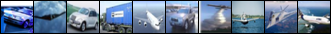

Train accuracy of truck = 43.26%
Hard negatives for truck


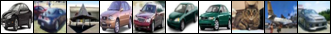


Test accuracy of the network: 34.61%
Test accuracy of plane = 48.50%
Hard negatives for plane


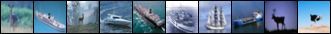

Test accuracy of car = 36.40%
Hard negatives for car


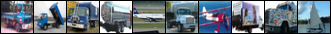

Test accuracy of bird = 18.00%
Hard negatives for bird


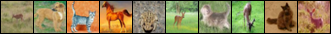

Test accuracy of cat = 17.40%
Hard negatives for cat


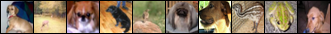

Test accuracy of deer = 23.20%
Hard negatives for deer


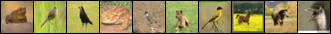

Test accuracy of dog = 30.50%
Hard negatives for dog


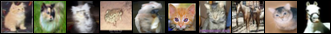

Test accuracy of frog = 43.50%
Hard negatives for frog


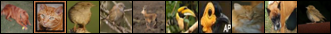

Test accuracy of horse = 35.00%
Hard negatives for horse


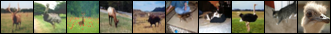

Test accuracy of ship = 52.20%
Hard negatives for ship


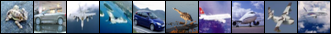

Test accuracy of truck = 41.40%
Hard negatives for truck


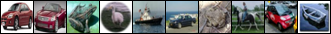

In [51]:

train_losses2, train_accuracies2, test_accuracies2 = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.1, 
    epochs=30, 
    batch_size=300)


train_losses3, train_accuracies3, test_accuracies3 = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    lr=0.0001, 
    epochs=30, 
    batch_size=300)




lr = 10
train_loss:  10.739156437491229
train_accuracies:  0.22732
test_accuracies:  0.2269
lr = 0.1
train_loss:  1.80876552416179
train_accuracies:  0.36128
test_accuracies:  0.3455
lr = 0.0001
train_loss:  1.7994068639720986
train_accuracies:  0.36192
test_accuracies:  0.3461


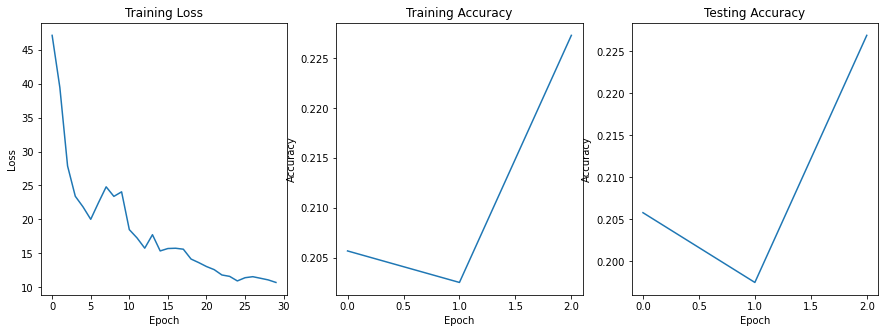

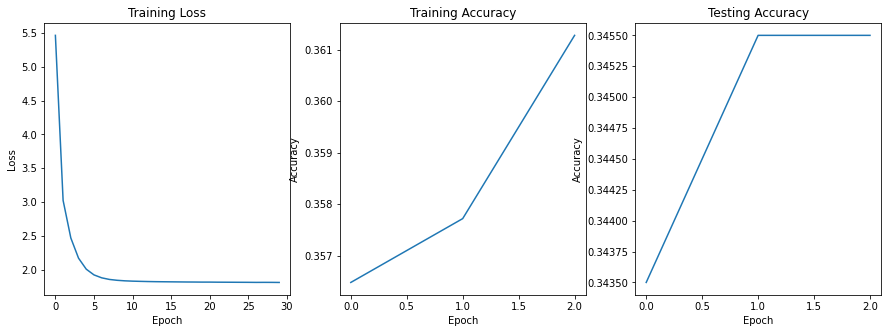

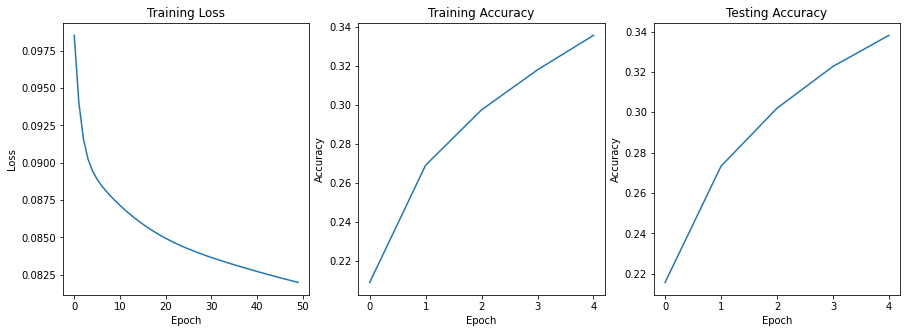

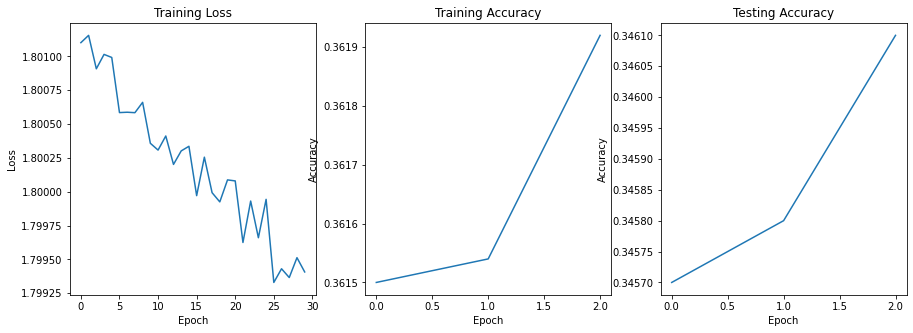

In [65]:
plot_results(train_losses1, train_accuracies1, test_accuracies1)
plot_results(train_losses2, train_accuracies2, test_accuracies2)
plot_results(train_losses3, train_accuracies3, test_accuracies3)


print("lr = 10")
print("train_loss: ",train_losses1[-1])
print("train_accuracies: ",train_accuracies1[-1])
print("test_accuracies: ",test_accuracies1[-1])

print("lr = 0.1")
print("train_loss: ",train_losses2[-1])
print("train_accuracies: ",train_accuracies2[-1])
print("test_accuracies: ",test_accuracies2[-1])

print("lr = 0.0001")
print("train_loss: ",train_losses3[-1])
print("train_accuracies: ",train_accuracies3[-1])
print("test_accuracies: ",test_accuracies3[-1])


**Question**:
Analyze the results and choose one value to use. Why did you choose this value?

Batch size = 300, epochs = 30
lr = 10
train_loss:  10.739156437491229
train_accuracies:  0.22732
test_accuracies:  0.2269

lr = 0.1
train_loss:  1.80876552416179
train_accuracies:  0.36128
test_accuracies:  0.3455

lr = 0.01
train_loss:  1.3429241937077687
train_accuracies:  0.52366
test_accuracies:  0.5216

lr = 0.0001
train_loss:  1.7994068639720986
train_accuracies:  0.36192
test_accuracies:  0.3461

I choose learning rate = 0.01 because it will have the highest accuracy.
When learning rate is too large, accuracy decreases because it will adjust too much to the model. When learning rate is tiny, accuracy also become small because the model needs more time to converge.

### 2.3.3. Learning rate scheduling
During training it is often useful to reduce learning rate as the training progresses.

Fill in `set_learning_rate` below to scale the learning rate by 0.1 (reduce by 90%) every 30 epochs and observe the behavior of network for 90 epochs. 


In [0]:
def set_learning_rate(optimizer, epoch, base_lr):
    # TODO: adjust learning rate here
    # lr = ...
    if epoch<30:
      lr = base_lr
    elif epoch<60:
        lr = 0.1 * base_lr
    else:
        lr = 0.1 * 0.1 * base_lr
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 2.227



Epoch 1 summary -- loss = 2.059



Epoch 2 summary -- loss = 1.973



Epoch 3 summary -- loss = 1.915



Epoch 4 summary -- loss = 1.868



Epoch 5 summary -- loss = 1.826



Epoch 6 summary -- loss = 1.786



Epoch 7 summary -- loss = 1.741



Epoch 8 summary -- loss = 1.694



Epoch 9 summary -- loss = 1.657
Evaluating epoch 10



Train accuracy of the network: 42.15%
Train accuracy of plane = 48.96%
Hard negatives for plane


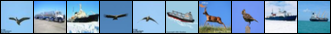

Train accuracy of car = 49.78%
Hard negatives for car


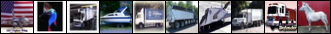

Train accuracy of bird = 30.22%
Hard negatives for bird


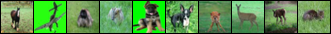

Train accuracy of cat = 17.24%
Hard negatives for cat


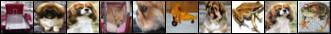

Train accuracy of deer = 35.58%
Hard negatives for deer


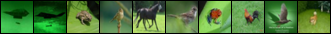

Train accuracy of dog = 33.24%
Hard negatives for dog


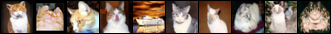

Train accuracy of frog = 58.86%
Hard negatives for frog


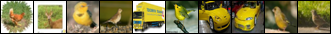

Train accuracy of horse = 44.16%
Hard negatives for horse


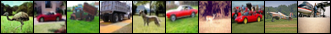

Train accuracy of ship = 53.26%
Hard negatives for ship


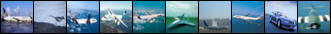

Train accuracy of truck = 50.24%
Hard negatives for truck


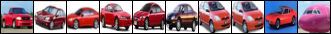


Test accuracy of the network: 42.99%
Test accuracy of plane = 50.00%
Hard negatives for plane


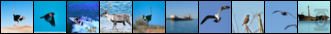

Test accuracy of car = 51.40%
Hard negatives for car


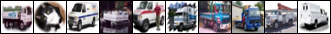

Test accuracy of bird = 31.30%
Hard negatives for bird


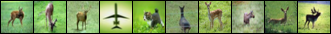

Test accuracy of cat = 18.10%
Hard negatives for cat


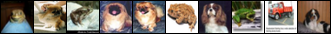

Test accuracy of deer = 34.80%
Hard negatives for deer


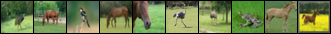

Test accuracy of dog = 33.90%
Hard negatives for dog


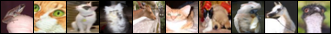

Test accuracy of frog = 61.60%
Hard negatives for frog


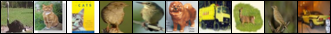

Test accuracy of horse = 46.60%
Hard negatives for horse


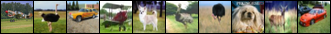

Test accuracy of ship = 53.90%
Hard negatives for ship


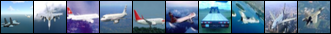

Test accuracy of truck = 48.30%
Hard negatives for truck


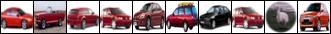


Epoch 10 summary -- loss = 1.628



Epoch 11 summary -- loss = 1.602



Epoch 12 summary -- loss = 1.580



Epoch 13 summary -- loss = 1.558



Epoch 14 summary -- loss = 1.540



Epoch 15 summary -- loss = 1.524



Epoch 16 summary -- loss = 1.509



Epoch 17 summary -- loss = 1.495



Epoch 18 summary -- loss = 1.482



Epoch 19 summary -- loss = 1.471
Evaluating epoch 20



Train accuracy of the network: 48.15%
Train accuracy of plane = 49.74%
Hard negatives for plane


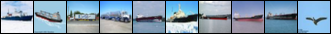

Train accuracy of car = 61.98%
Hard negatives for car


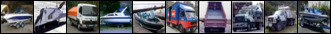

Train accuracy of bird = 36.98%
Hard negatives for bird


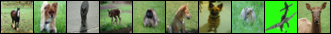

Train accuracy of cat = 31.00%
Hard negatives for cat


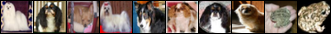

Train accuracy of deer = 36.48%
Hard negatives for deer


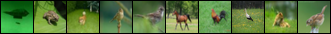

Train accuracy of dog = 39.82%
Hard negatives for dog


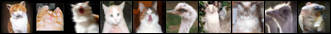

Train accuracy of frog = 54.32%
Hard negatives for frog


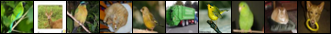

Train accuracy of horse = 54.30%
Hard negatives for horse


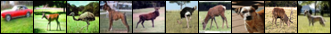

Train accuracy of ship = 61.54%
Hard negatives for ship


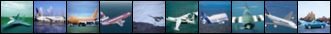

Train accuracy of truck = 55.32%
Hard negatives for truck


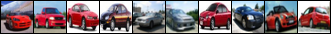


Test accuracy of the network: 48.19%
Test accuracy of plane = 51.20%
Hard negatives for plane


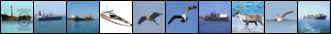

Test accuracy of car = 62.40%
Hard negatives for car


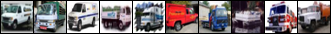

Test accuracy of bird = 36.30%
Hard negatives for bird


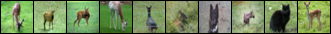

Test accuracy of cat = 30.60%
Hard negatives for cat


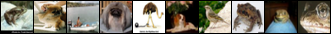

Test accuracy of deer = 36.10%
Hard negatives for deer


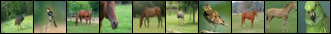

Test accuracy of dog = 39.10%
Hard negatives for dog


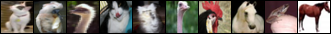

Test accuracy of frog = 56.30%
Hard negatives for frog


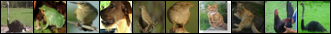

Test accuracy of horse = 54.60%
Hard negatives for horse


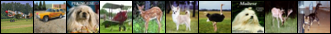

Test accuracy of ship = 61.90%
Hard negatives for ship


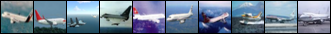

Test accuracy of truck = 53.40%
Hard negatives for truck


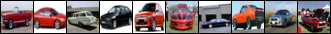


Epoch 20 summary -- loss = 1.458



Epoch 21 summary -- loss = 1.447



Epoch 22 summary -- loss = 1.436



Epoch 23 summary -- loss = 1.424



Epoch 24 summary -- loss = 1.413



Epoch 25 summary -- loss = 1.402



Epoch 26 summary -- loss = 1.391



Epoch 27 summary -- loss = 1.379



Epoch 28 summary -- loss = 1.367



Epoch 29 summary -- loss = 1.355
Evaluating epoch 30



Train accuracy of the network: 52.22%
Train accuracy of plane = 56.92%
Hard negatives for plane


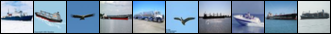

Train accuracy of car = 66.78%
Hard negatives for car


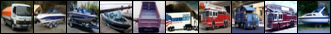

Train accuracy of bird = 37.24%
Hard negatives for bird


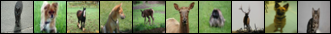

Train accuracy of cat = 35.46%
Hard negatives for cat


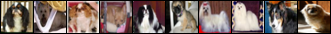

Train accuracy of deer = 40.06%
Hard negatives for deer


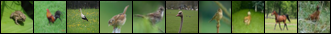

Train accuracy of dog = 43.14%
Hard negatives for dog


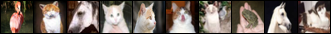

Train accuracy of frog = 60.60%
Hard negatives for frog


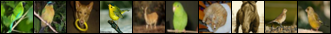

Train accuracy of horse = 56.52%
Hard negatives for horse


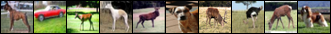

Train accuracy of ship = 65.88%
Hard negatives for ship


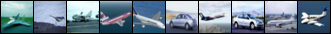

Train accuracy of truck = 59.64%
Hard negatives for truck


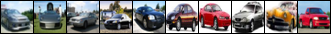


Test accuracy of the network: 51.44%
Test accuracy of plane = 58.00%
Hard negatives for plane


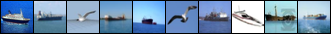

Test accuracy of car = 66.50%
Hard negatives for car


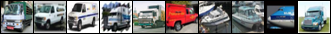

Test accuracy of bird = 35.40%
Hard negatives for bird


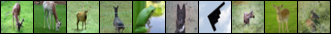

Test accuracy of cat = 33.30%
Hard negatives for cat


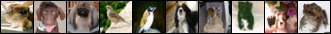

Test accuracy of deer = 39.20%
Hard negatives for deer


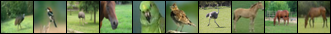

Test accuracy of dog = 41.70%
Hard negatives for dog


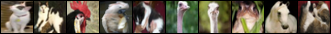

Test accuracy of frog = 63.40%
Hard negatives for frog


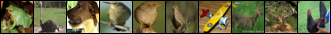

Test accuracy of horse = 57.00%
Hard negatives for horse


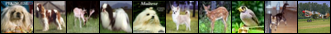

Test accuracy of ship = 64.60%
Hard negatives for ship


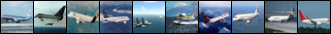

Test accuracy of truck = 55.30%
Hard negatives for truck


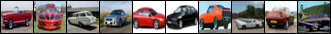


Epoch 30 summary -- loss = 1.345



Epoch 31 summary -- loss = 1.344



Epoch 32 summary -- loss = 1.342



Epoch 33 summary -- loss = 1.341



Epoch 34 summary -- loss = 1.340



Epoch 35 summary -- loss = 1.339



Epoch 36 summary -- loss = 1.338



Epoch 37 summary -- loss = 1.337



Epoch 38 summary -- loss = 1.336



Epoch 39 summary -- loss = 1.334
Evaluating epoch 40



Train accuracy of the network: 52.74%
Train accuracy of plane = 55.46%
Hard negatives for plane


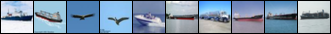

Train accuracy of car = 66.34%
Hard negatives for car


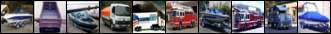

Train accuracy of bird = 38.28%
Hard negatives for bird


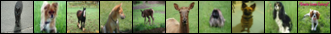

Train accuracy of cat = 33.92%
Hard negatives for cat


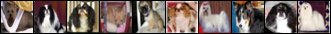

Train accuracy of deer = 41.72%
Hard negatives for deer


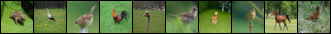

Train accuracy of dog = 44.90%
Hard negatives for dog


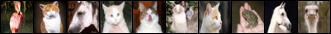

Train accuracy of frog = 61.16%
Hard negatives for frog


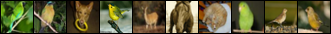

Train accuracy of horse = 57.14%
Hard negatives for horse


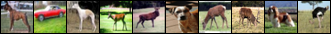

Train accuracy of ship = 68.06%
Hard negatives for ship


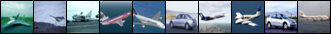

Train accuracy of truck = 60.38%
Hard negatives for truck


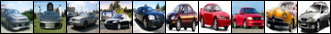


Test accuracy of the network: 52.07%
Test accuracy of plane = 55.70%
Hard negatives for plane


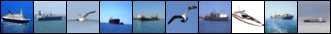

Test accuracy of car = 66.50%
Hard negatives for car


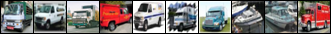

Test accuracy of bird = 36.70%
Hard negatives for bird


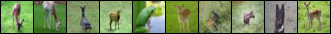

Test accuracy of cat = 32.30%
Hard negatives for cat


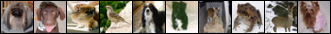

Test accuracy of deer = 40.10%
Hard negatives for deer


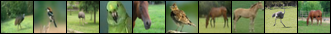

Test accuracy of dog = 44.10%
Hard negatives for dog


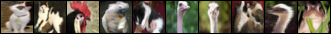

Test accuracy of frog = 63.70%
Hard negatives for frog


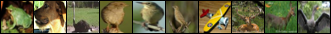

Test accuracy of horse = 57.70%
Hard negatives for horse


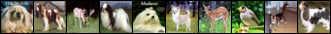

Test accuracy of ship = 67.60%
Hard negatives for ship


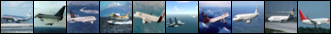

Test accuracy of truck = 56.30%
Hard negatives for truck


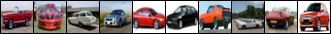


Epoch 40 summary -- loss = 1.333



Epoch 41 summary -- loss = 1.332



Epoch 42 summary -- loss = 1.331



Epoch 43 summary -- loss = 1.330



Epoch 44 summary -- loss = 1.329



Epoch 45 summary -- loss = 1.327



Epoch 46 summary -- loss = 1.326



Epoch 47 summary -- loss = 1.325



Epoch 48 summary -- loss = 1.324



Epoch 49 summary -- loss = 1.323
Evaluating epoch 50



Train accuracy of the network: 53.15%
Train accuracy of plane = 55.64%
Hard negatives for plane


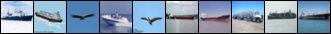

Train accuracy of car = 66.58%
Hard negatives for car


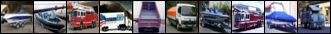

Train accuracy of bird = 38.62%
Hard negatives for bird


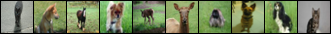

Train accuracy of cat = 34.54%
Hard negatives for cat


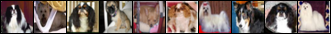

Train accuracy of deer = 40.90%
Hard negatives for deer


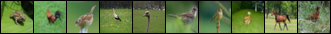

Train accuracy of dog = 46.14%
Hard negatives for dog


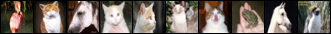

Train accuracy of frog = 61.76%
Hard negatives for frog


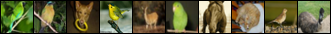

Train accuracy of horse = 58.02%
Hard negatives for horse


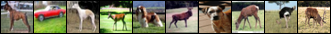

Train accuracy of ship = 67.94%
Hard negatives for ship


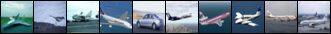

Train accuracy of truck = 61.34%
Hard negatives for truck


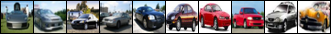


Test accuracy of the network: 52.20%
Test accuracy of plane = 56.00%
Hard negatives for plane


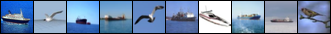

Test accuracy of car = 66.40%
Hard negatives for car


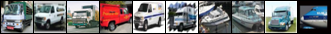

Test accuracy of bird = 36.90%
Hard negatives for bird


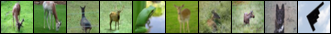

Test accuracy of cat = 32.10%
Hard negatives for cat


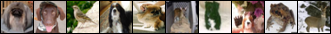

Test accuracy of deer = 38.80%
Hard negatives for deer


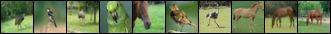

Test accuracy of dog = 44.30%
Hard negatives for dog


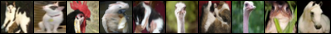

Test accuracy of frog = 64.90%
Hard negatives for frog


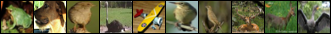

Test accuracy of horse = 58.40%
Hard negatives for horse


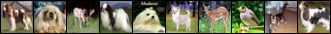

Test accuracy of ship = 67.40%
Hard negatives for ship


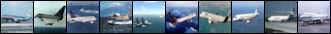

Test accuracy of truck = 56.80%
Hard negatives for truck


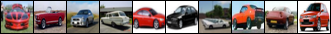


Epoch 50 summary -- loss = 1.322



Epoch 51 summary -- loss = 1.321



Epoch 52 summary -- loss = 1.320



Epoch 53 summary -- loss = 1.319



Epoch 54 summary -- loss = 1.317



Epoch 55 summary -- loss = 1.316



Epoch 56 summary -- loss = 1.315



Epoch 57 summary -- loss = 1.314



Epoch 58 summary -- loss = 1.313



Epoch 59 summary -- loss = 1.312
Evaluating epoch 60



Train accuracy of the network: 53.57%
Train accuracy of plane = 56.32%
Hard negatives for plane


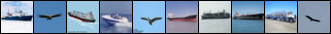

Train accuracy of car = 67.46%
Hard negatives for car


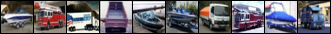

Train accuracy of bird = 39.80%
Hard negatives for bird


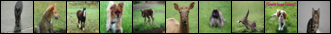

Train accuracy of cat = 35.32%
Hard negatives for cat


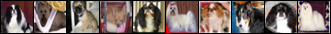

Train accuracy of deer = 41.00%
Hard negatives for deer


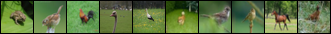

Train accuracy of dog = 46.06%
Hard negatives for dog


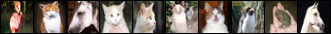

Train accuracy of frog = 61.36%
Hard negatives for frog


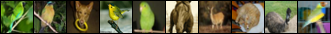

Train accuracy of horse = 58.22%
Hard negatives for horse


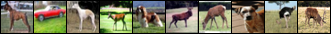

Train accuracy of ship = 68.98%
Hard negatives for ship


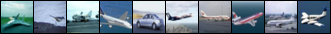

Train accuracy of truck = 61.14%
Hard negatives for truck


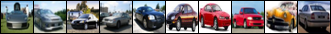


Test accuracy of the network: 52.57%
Test accuracy of plane = 56.20%
Hard negatives for plane


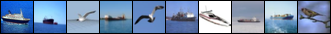

Test accuracy of car = 67.00%
Hard negatives for car


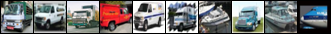

Test accuracy of bird = 37.80%
Hard negatives for bird


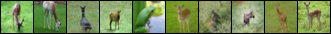

Test accuracy of cat = 33.20%
Hard negatives for cat


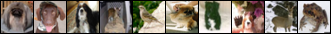

Test accuracy of deer = 38.70%
Hard negatives for deer


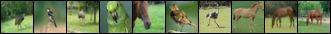

Test accuracy of dog = 43.80%
Hard negatives for dog


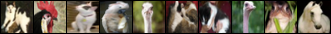

Test accuracy of frog = 64.90%
Hard negatives for frog


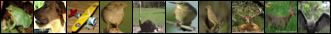

Test accuracy of horse = 58.70%
Hard negatives for horse


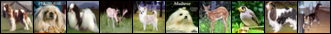

Test accuracy of ship = 68.70%
Hard negatives for ship


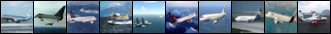

Test accuracy of truck = 56.70%
Hard negatives for truck


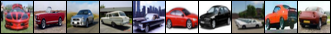


Epoch 60 summary -- loss = 1.311



Epoch 61 summary -- loss = 1.311



Epoch 62 summary -- loss = 1.311



Epoch 63 summary -- loss = 1.311



Epoch 64 summary -- loss = 1.310



Epoch 65 summary -- loss = 1.310



Epoch 66 summary -- loss = 1.310



Epoch 67 summary -- loss = 1.310



Epoch 68 summary -- loss = 1.310



Epoch 69 summary -- loss = 1.310
Evaluating epoch 70



Train accuracy of the network: 53.60%
Train accuracy of plane = 56.38%
Hard negatives for plane


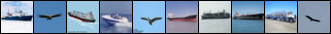

Train accuracy of car = 67.18%
Hard negatives for car


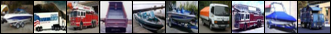

Train accuracy of bird = 39.22%
Hard negatives for bird


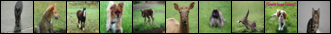

Train accuracy of cat = 35.14%
Hard negatives for cat


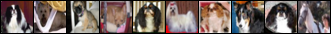

Train accuracy of deer = 41.16%
Hard negatives for deer


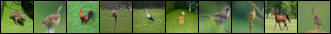

Train accuracy of dog = 46.40%
Hard negatives for dog


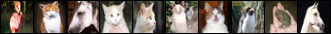

Train accuracy of frog = 61.70%
Hard negatives for frog


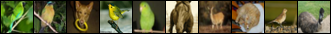

Train accuracy of horse = 58.64%
Hard negatives for horse


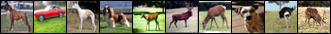

Train accuracy of ship = 68.72%
Hard negatives for ship


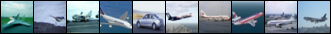

Train accuracy of truck = 61.46%
Hard negatives for truck


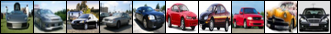


Test accuracy of the network: 52.67%
Test accuracy of plane = 56.50%
Hard negatives for plane


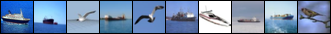

Test accuracy of car = 66.60%
Hard negatives for car


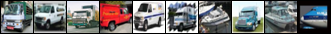

Test accuracy of bird = 37.30%
Hard negatives for bird


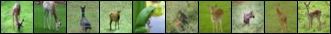

Test accuracy of cat = 33.50%
Hard negatives for cat


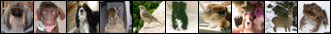

Test accuracy of deer = 38.60%
Hard negatives for deer


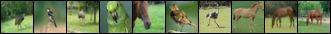

Test accuracy of dog = 43.90%
Hard negatives for dog


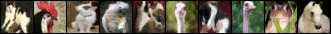

Test accuracy of frog = 65.50%
Hard negatives for frog


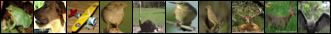

Test accuracy of horse = 59.00%
Hard negatives for horse


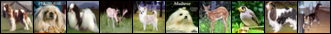

Test accuracy of ship = 68.20%
Hard negatives for ship


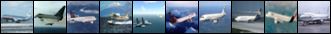

Test accuracy of truck = 57.60%
Hard negatives for truck


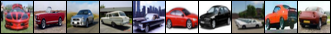


Epoch 70 summary -- loss = 1.310



Epoch 71 summary -- loss = 1.310



Epoch 72 summary -- loss = 1.310



Epoch 73 summary -- loss = 1.310



Epoch 74 summary -- loss = 1.310



Epoch 75 summary -- loss = 1.309



Epoch 76 summary -- loss = 1.309



Epoch 77 summary -- loss = 1.309



Epoch 78 summary -- loss = 1.309



Epoch 79 summary -- loss = 1.309
Evaluating epoch 80



Train accuracy of the network: 53.61%
Train accuracy of plane = 56.38%
Hard negatives for plane


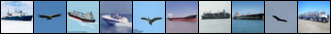

Train accuracy of car = 67.22%
Hard negatives for car


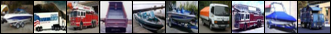

Train accuracy of bird = 39.08%
Hard negatives for bird


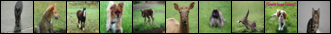

Train accuracy of cat = 35.14%
Hard negatives for cat


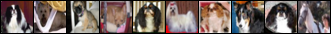

Train accuracy of deer = 41.26%
Hard negatives for deer


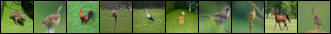

Train accuracy of dog = 46.40%
Hard negatives for dog


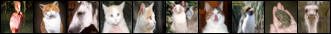

Train accuracy of frog = 61.74%
Hard negatives for frog


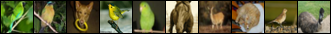

Train accuracy of horse = 58.66%
Hard negatives for horse


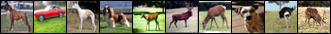

Train accuracy of ship = 68.74%
Hard negatives for ship


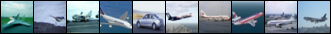

Train accuracy of truck = 61.48%
Hard negatives for truck


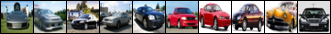


Test accuracy of the network: 52.69%
Test accuracy of plane = 56.50%
Hard negatives for plane


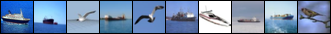

Test accuracy of car = 66.70%
Hard negatives for car


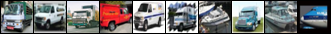

Test accuracy of bird = 37.30%
Hard negatives for bird


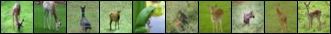

Test accuracy of cat = 33.40%
Hard negatives for cat


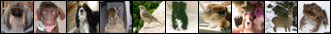

Test accuracy of deer = 38.60%
Hard negatives for deer


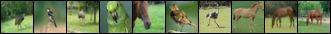

Test accuracy of dog = 43.80%
Hard negatives for dog


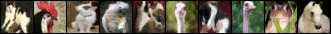

Test accuracy of frog = 65.60%
Hard negatives for frog


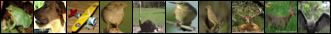

Test accuracy of horse = 59.00%
Hard negatives for horse


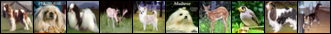

Test accuracy of ship = 68.30%
Hard negatives for ship


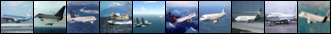

Test accuracy of truck = 57.70%
Hard negatives for truck


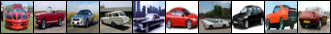


Epoch 80 summary -- loss = 1.309



Epoch 81 summary -- loss = 1.309



Epoch 82 summary -- loss = 1.309



Epoch 83 summary -- loss = 1.308



Epoch 84 summary -- loss = 1.308



Epoch 85 summary -- loss = 1.308



Epoch 86 summary -- loss = 1.308



Epoch 87 summary -- loss = 1.308



Epoch 88 summary -- loss = 1.308



Epoch 89 summary -- loss = 1.308
Evaluating epoch 90



Train accuracy of the network: 53.67%
Train accuracy of plane = 56.42%
Hard negatives for plane


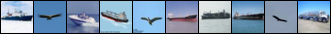

Train accuracy of car = 67.22%
Hard negatives for car


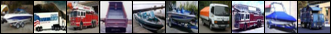

Train accuracy of bird = 39.04%
Hard negatives for bird


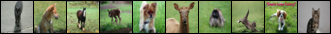

Train accuracy of cat = 35.28%
Hard negatives for cat


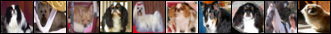

Train accuracy of deer = 41.30%
Hard negatives for deer


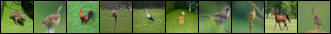

Train accuracy of dog = 46.46%
Hard negatives for dog


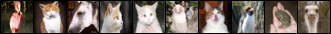

Train accuracy of frog = 61.80%
Hard negatives for frog


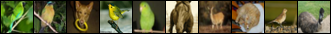

Train accuracy of horse = 58.78%
Hard negatives for horse


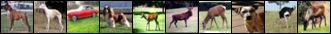

Train accuracy of ship = 68.80%
Hard negatives for ship


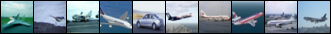

Train accuracy of truck = 61.56%
Hard negatives for truck


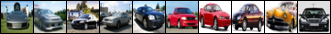


Test accuracy of the network: 52.71%
Test accuracy of plane = 56.50%
Hard negatives for plane


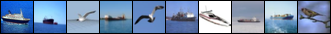

Test accuracy of car = 66.60%
Hard negatives for car


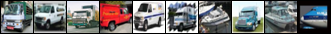

Test accuracy of bird = 37.30%
Hard negatives for bird


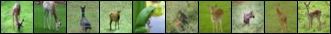

Test accuracy of cat = 33.50%
Hard negatives for cat


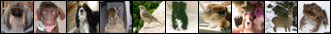

Test accuracy of deer = 38.60%
Hard negatives for deer


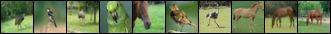

Test accuracy of dog = 43.90%
Hard negatives for dog


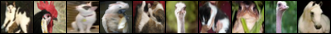

Test accuracy of frog = 65.70%
Hard negatives for frog


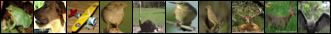

Test accuracy of horse = 59.00%
Hard negatives for horse


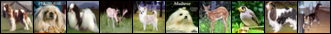

Test accuracy of ship = 68.30%
Hard negatives for ship


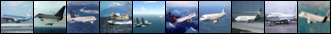

Test accuracy of truck = 57.70%
Hard negatives for truck


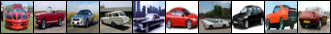

In [60]:
net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    lr_func=set_learning_rate,
    criterion=nn.CrossEntropyLoss(),
    lr=0.01, 
    epochs=90, 
    batch_size=300)

In [1]:
plot_results(train_losses, train_accuracies, test_accuracies)

print("train_loss: ",train_losses[-1])
print("train_accuracies: ",train_accuracies[-1])
print("test_accuracies: ",test_accuracies[-1])

NameError: ignored

**Question**: 
What do you observe? Why do you think it is useful to decrease the learning rate over time?


As epochs increases, the learning rate become smaller, and accuracy become better.

If the learning rate is a constant, it may perform well at first. But when the model is accurate and stable, there is no need to adjust model too much. What we need is adjust the model slightly.

### 2.3.4. Data Augmentation

Most of the popular computer vision datasets have tens of thousands of images. 

Cifar-10 is a dataset of 60000 32x32 colour images in 10 classes, which can be relatively small in compare to ImageNet which has 1M images. 

The more the number of parameters is, the more likely our model is to overfit to the small dataset. 
As you might have already faced this issue while training the CoolNet, after some iterations the training accuracy reaches its maximum (saturates) while the test accuracy is still relatively low. 

To solve this problem, we use the data augmentation to help the network avoid overfitting.

Add data transformations in to the class below and compare the results. You are free to use any type and any number of data augmentation techniques.

Just be aware that data augmentation should just happen during training phase. 

In [0]:
train_transform1 = transforms.Compose([
    # TODO: Add data augmentations here
    # You can find a list of transforms here:
    #  https://pytorch.org/docs/stable/torchvision/transforms.html
    #transforms.RandomCrop(3),
    transforms.RandomRotation(50),
    transforms.ToTensor(),
    #transforms.RandomHorizontalFlip(),
    
    # Normalize rescales and shifts the data so that it has a zero mean 
    # and unit variance. This reduces bias and makes it easier to learn!
    # The values here are the mean and variance of our inputs.
    # This will change the input images to be centered at 0 and be 
    # between -1 and 1.
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    #transforms.RandomErasing(),
])

Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 2.300



Epoch 1 summary -- loss = 2.281



Epoch 2 summary -- loss = 2.245



Epoch 3 summary -- loss = 2.194



Epoch 4 summary -- loss = 2.148



Epoch 5 summary -- loss = 2.112



Epoch 6 summary -- loss = 2.084



Epoch 7 summary -- loss = 2.060



Epoch 8 summary -- loss = 2.039



Epoch 9 summary -- loss = 2.021
Evaluating epoch 10



Train accuracy of the network: 27.15%
Train accuracy of plane = 45.88%
Hard negatives for plane


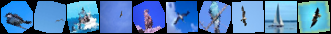

Train accuracy of car = 17.36%
Hard negatives for car


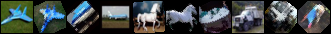

Train accuracy of bird = 3.22%
Hard negatives for bird


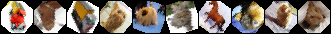

Train accuracy of cat = 3.88%
Hard negatives for cat


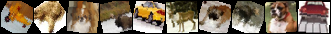

Train accuracy of deer = 5.02%
Hard negatives for deer


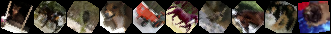

Train accuracy of dog = 31.70%
Hard negatives for dog


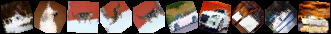

Train accuracy of frog = 65.88%
Hard negatives for frog


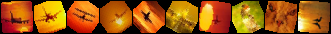

Train accuracy of horse = 15.96%
Hard negatives for horse


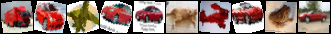

Train accuracy of ship = 43.74%
Hard negatives for ship


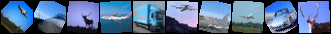

Train accuracy of truck = 39.54%
Hard negatives for truck


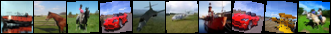


Test accuracy of the network: 27.69%
Test accuracy of plane = 48.00%
Hard negatives for plane


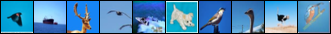

Test accuracy of car = 17.10%
Hard negatives for car


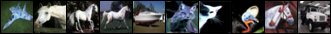

Test accuracy of bird = 0.40%
Hard negatives for bird


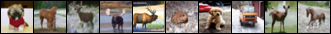

Test accuracy of cat = 3.00%
Hard negatives for cat


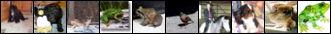

Test accuracy of deer = 0.90%
Hard negatives for deer


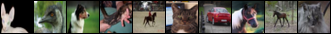

Test accuracy of dog = 26.00%
Hard negatives for dog


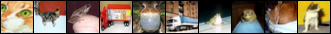

Test accuracy of frog = 68.80%
Hard negatives for frog


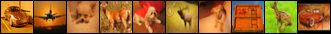

Test accuracy of horse = 18.30%
Hard negatives for horse


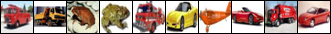

Test accuracy of ship = 44.00%
Hard negatives for ship


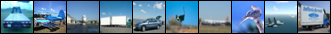

Test accuracy of truck = 50.40%
Hard negatives for truck


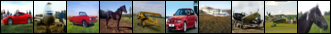


Epoch 10 summary -- loss = 2.005



Epoch 11 summary -- loss = 1.992



Epoch 12 summary -- loss = 1.980



Epoch 13 summary -- loss = 1.970



Epoch 14 summary -- loss = 1.961



Epoch 15 summary -- loss = 1.951



Epoch 16 summary -- loss = 1.942



Epoch 17 summary -- loss = 1.933



Epoch 18 summary -- loss = 1.922



Epoch 19 summary -- loss = 1.915
Evaluating epoch 20



Train accuracy of the network: 32.48%
Train accuracy of plane = 43.72%
Hard negatives for plane


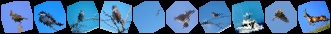

Train accuracy of car = 34.46%
Hard negatives for car


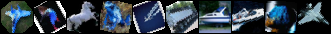

Train accuracy of bird = 6.68%
Hard negatives for bird


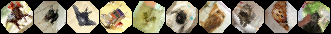

Train accuracy of cat = 11.74%
Hard negatives for cat


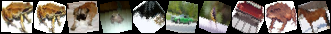

Train accuracy of deer = 17.64%
Hard negatives for deer


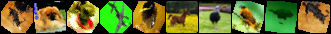

Train accuracy of dog = 34.10%
Hard negatives for dog


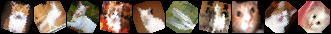

Train accuracy of frog = 58.50%
Hard negatives for frog


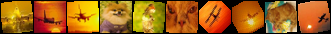

Train accuracy of horse = 28.52%
Hard negatives for horse


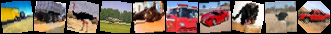

Train accuracy of ship = 48.96%
Hard negatives for ship


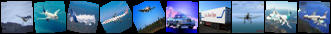

Train accuracy of truck = 39.78%
Hard negatives for truck


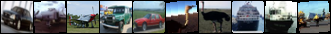


Test accuracy of the network: 33.25%
Test accuracy of plane = 43.00%
Hard negatives for plane


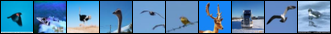

Test accuracy of car = 34.50%
Hard negatives for car


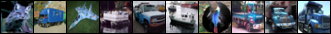

Test accuracy of bird = 1.60%
Hard negatives for bird


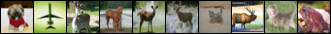

Test accuracy of cat = 10.40%
Hard negatives for cat


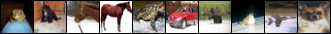

Test accuracy of deer = 8.70%
Hard negatives for deer


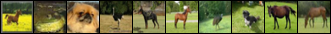

Test accuracy of dog = 28.00%
Hard negatives for dog


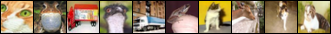

Test accuracy of frog = 67.50%
Hard negatives for frog


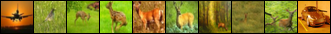

Test accuracy of horse = 38.30%
Hard negatives for horse


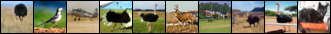

Test accuracy of ship = 48.40%
Hard negatives for ship


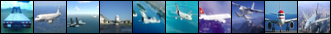

Test accuracy of truck = 52.10%
Hard negatives for truck


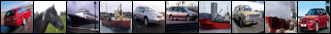


Epoch 20 summary -- loss = 1.903



Epoch 21 summary -- loss = 1.892



Epoch 22 summary -- loss = 1.882



Epoch 23 summary -- loss = 1.870



Epoch 24 summary -- loss = 1.859



Epoch 25 summary -- loss = 1.846



Epoch 26 summary -- loss = 1.834



Epoch 27 summary -- loss = 1.823



Epoch 28 summary -- loss = 1.814



Epoch 29 summary -- loss = 1.804
Evaluating epoch 30



Train accuracy of the network: 36.71%
Train accuracy of plane = 43.76%
Hard negatives for plane


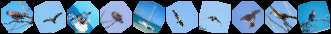

Train accuracy of car = 44.60%
Hard negatives for car


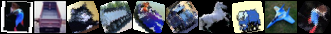

Train accuracy of bird = 12.56%
Hard negatives for bird


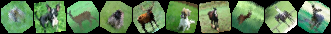

Train accuracy of cat = 16.70%
Hard negatives for cat


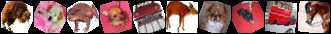

Train accuracy of deer = 31.82%
Hard negatives for deer


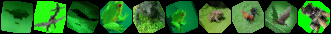

Train accuracy of dog = 32.48%
Hard negatives for dog


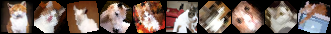

Train accuracy of frog = 53.86%
Hard negatives for frog


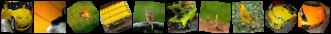

Train accuracy of horse = 39.64%
Hard negatives for horse


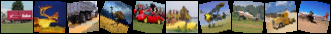

Train accuracy of ship = 52.38%
Hard negatives for ship


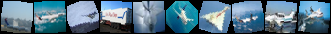

Train accuracy of truck = 41.70%
Hard negatives for truck


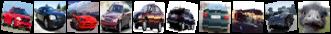


Test accuracy of the network: 38.03%
Test accuracy of plane = 41.40%
Hard negatives for plane


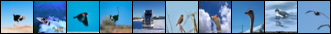

Test accuracy of car = 48.70%
Hard negatives for car


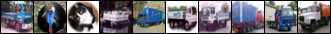

Test accuracy of bird = 5.40%
Hard negatives for bird


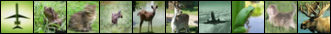

Test accuracy of cat = 14.30%
Hard negatives for cat


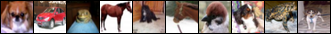

Test accuracy of deer = 25.20%
Hard negatives for deer


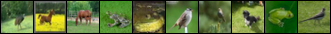

Test accuracy of dog = 28.10%
Hard negatives for dog


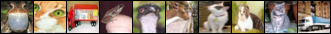

Test accuracy of frog = 63.70%
Hard negatives for frog


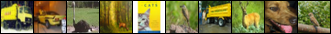

Test accuracy of horse = 51.60%
Hard negatives for horse


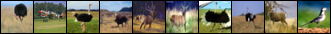

Test accuracy of ship = 52.10%
Hard negatives for ship


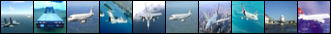

Test accuracy of truck = 49.80%
Hard negatives for truck


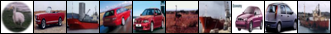

In [14]:
net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=nn.CrossEntropyLoss(),
    train_transform=train_transform1,
    lr=0.01, 
    epochs=30, 
    batch_size=1024)

train_loss:  1.8038627517466643
train_accuracies:  0.36706
test_accuracies:  0.3803


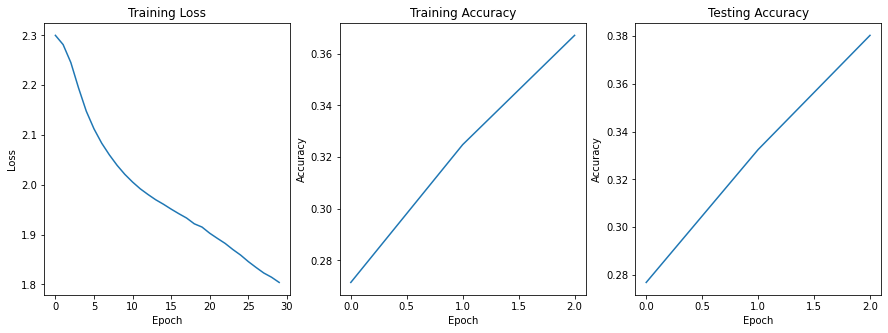

In [16]:
plot_results(train_losses, train_accuracies, test_accuracies)
print("train_loss: ",train_losses[-1])
print("train_accuracies: ",train_accuracies[-1])
print("test_accuracies: ",test_accuracies[-1])

**Question**: How does the model trained with data augmentation compared to the model trained without?

lr = 0.01, batch size = 1024

with data augmentation:
train_loss:  1.8038627517466643
train_accuracies:  0.36706
test_accuracies:  0.3803

without data augmentation:
train_loss:  1.6371715628370946
train_accuracies:  0.42206
test_accuracies:  0.4239

Model with augmentation has higher train loss and lower accuracy. However, test accuracy would be higher than train accuracy, which means it can avoid overfitting.


### 2.3.5. Change the loss function

Try Mean Squared Error loss instead of Cross Entropy.

Files already downloaded and verified
Files already downloaded and verified


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:1558: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")



Epoch 0 summary -- loss = 0.099



Epoch 1 summary -- loss = 0.094



Epoch 2 summary -- loss = 0.092



Epoch 3 summary -- loss = 0.090



Epoch 4 summary -- loss = 0.089



Epoch 5 summary -- loss = 0.089



Epoch 6 summary -- loss = 0.088



Epoch 7 summary -- loss = 0.088



Epoch 8 summary -- loss = 0.088



Epoch 9 summary -- loss = 0.087
Evaluating epoch 10



Train accuracy of the network: 20.89%
Train accuracy of plane = 38.76%
Hard negatives for plane


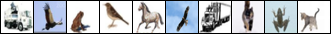

Train accuracy of car = 19.94%
Hard negatives for car


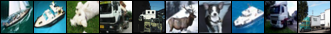

Train accuracy of bird = 3.60%
Hard negatives for bird


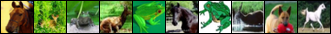

Train accuracy of cat = 19.26%
Hard negatives for cat


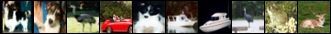

Train accuracy of deer = 12.10%
Hard negatives for deer


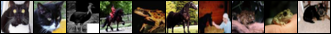

Train accuracy of dog = 15.48%
Hard negatives for dog


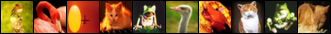

Train accuracy of frog = 26.88%
Hard negatives for frog


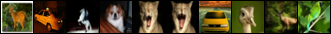

Train accuracy of horse = 17.10%
Hard negatives for horse


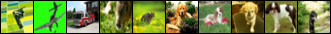

Train accuracy of ship = 24.56%
Hard negatives for ship


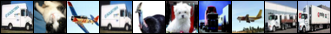

Train accuracy of truck = 31.20%
Hard negatives for truck


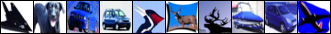


Test accuracy of the network: 21.57%
Test accuracy of plane = 42.70%
Hard negatives for plane


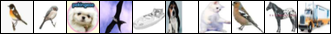

Test accuracy of car = 19.20%
Hard negatives for car


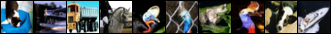

Test accuracy of bird = 3.90%
Hard negatives for bird


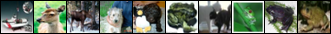

Test accuracy of cat = 19.50%
Hard negatives for cat


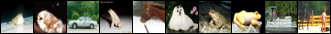

Test accuracy of deer = 14.50%
Hard negatives for deer


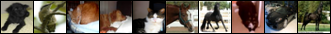

Test accuracy of dog = 15.60%
Hard negatives for dog


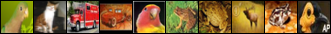

Test accuracy of frog = 26.60%
Hard negatives for frog


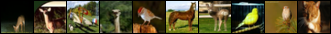

Test accuracy of horse = 17.00%
Hard negatives for horse


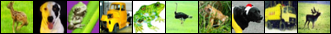

Test accuracy of ship = 26.80%
Hard negatives for ship


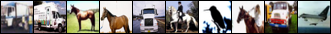

Test accuracy of truck = 29.90%
Hard negatives for truck


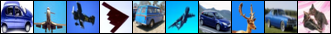


Epoch 10 summary -- loss = 0.087



Epoch 11 summary -- loss = 0.087



Epoch 12 summary -- loss = 0.087



Epoch 13 summary -- loss = 0.086



Epoch 14 summary -- loss = 0.086



Epoch 15 summary -- loss = 0.086



Epoch 16 summary -- loss = 0.086



Epoch 17 summary -- loss = 0.085



Epoch 18 summary -- loss = 0.085



Epoch 19 summary -- loss = 0.085
Evaluating epoch 20



Train accuracy of the network: 26.91%
Train accuracy of plane = 45.60%
Hard negatives for plane


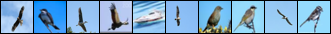

Train accuracy of car = 24.72%
Hard negatives for car


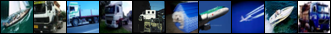

Train accuracy of bird = 2.54%
Hard negatives for bird


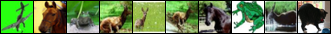

Train accuracy of cat = 16.86%
Hard negatives for cat


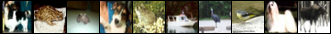

Train accuracy of deer = 18.50%
Hard negatives for deer


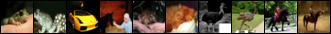

Train accuracy of dog = 21.36%
Hard negatives for dog


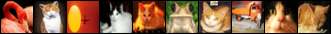

Train accuracy of frog = 41.04%
Hard negatives for frog


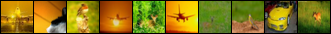

Train accuracy of horse = 15.08%
Hard negatives for horse


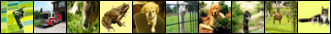

Train accuracy of ship = 45.24%
Hard negatives for ship


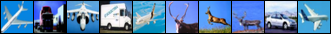

Train accuracy of truck = 38.18%
Hard negatives for truck


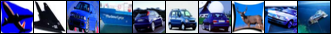


Test accuracy of the network: 27.33%
Test accuracy of plane = 49.90%
Hard negatives for plane


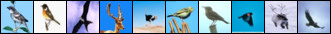

Test accuracy of car = 22.30%
Hard negatives for car


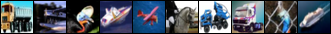

Test accuracy of bird = 3.30%
Hard negatives for bird


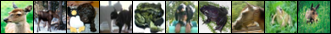

Test accuracy of cat = 16.90%
Hard negatives for cat


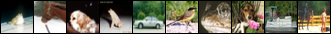

Test accuracy of deer = 19.10%
Hard negatives for deer


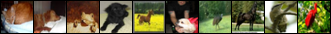

Test accuracy of dog = 20.60%
Hard negatives for dog


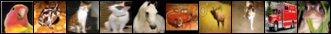

Test accuracy of frog = 41.60%
Hard negatives for frog


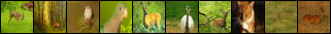

Test accuracy of horse = 15.10%
Hard negatives for horse


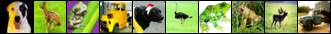

Test accuracy of ship = 47.50%
Hard negatives for ship


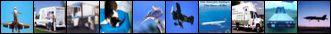

Test accuracy of truck = 37.00%
Hard negatives for truck


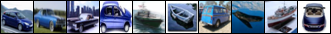


Epoch 20 summary -- loss = 0.085



Epoch 21 summary -- loss = 0.085



Epoch 22 summary -- loss = 0.085



Epoch 23 summary -- loss = 0.084



Epoch 24 summary -- loss = 0.084



Epoch 25 summary -- loss = 0.084



Epoch 26 summary -- loss = 0.084



Epoch 27 summary -- loss = 0.084



Epoch 28 summary -- loss = 0.084



Epoch 29 summary -- loss = 0.084
Evaluating epoch 30



Train accuracy of the network: 29.75%
Train accuracy of plane = 45.42%
Hard negatives for plane


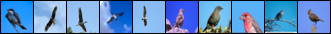

Train accuracy of car = 27.16%
Hard negatives for car


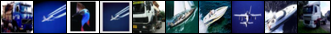

Train accuracy of bird = 2.66%
Hard negatives for bird


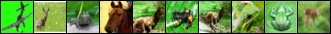

Train accuracy of cat = 14.52%
Hard negatives for cat


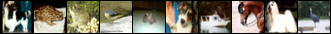

Train accuracy of deer = 20.84%
Hard negatives for deer


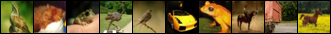

Train accuracy of dog = 26.16%
Hard negatives for dog


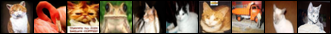

Train accuracy of frog = 46.70%
Hard negatives for frog


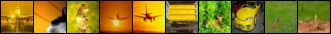

Train accuracy of horse = 17.40%
Hard negatives for horse


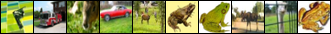

Train accuracy of ship = 52.32%
Hard negatives for ship


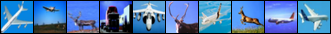

Train accuracy of truck = 44.36%
Hard negatives for truck


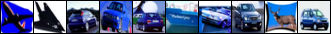


Test accuracy of the network: 30.20%
Test accuracy of plane = 49.90%
Hard negatives for plane


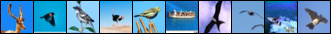

Test accuracy of car = 26.30%
Hard negatives for car


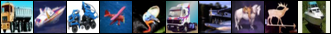

Test accuracy of bird = 3.00%
Hard negatives for bird


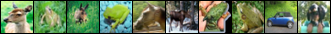

Test accuracy of cat = 14.20%
Hard negatives for cat


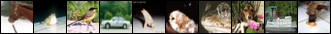

Test accuracy of deer = 21.80%
Hard negatives for deer


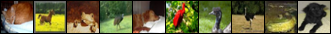

Test accuracy of dog = 25.60%
Hard negatives for dog


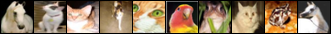

Test accuracy of frog = 47.40%
Hard negatives for frog


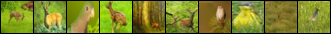

Test accuracy of horse = 18.80%
Hard negatives for horse


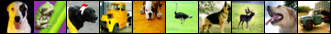

Test accuracy of ship = 53.10%
Hard negatives for ship


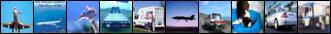

Test accuracy of truck = 41.90%
Hard negatives for truck


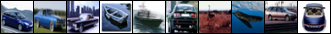


Epoch 30 summary -- loss = 0.084



Epoch 31 summary -- loss = 0.084



Epoch 32 summary -- loss = 0.083



Epoch 33 summary -- loss = 0.083



Epoch 34 summary -- loss = 0.083



Epoch 35 summary -- loss = 0.083



Epoch 36 summary -- loss = 0.083



Epoch 37 summary -- loss = 0.083



Epoch 38 summary -- loss = 0.083



Epoch 39 summary -- loss = 0.083
Evaluating epoch 40



Train accuracy of the network: 31.81%
Train accuracy of plane = 45.48%
Hard negatives for plane


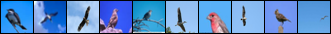

Train accuracy of car = 30.90%
Hard negatives for car


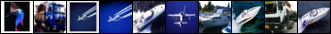

Train accuracy of bird = 3.94%
Hard negatives for bird


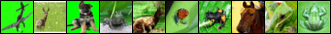

Train accuracy of cat = 13.08%
Hard negatives for cat


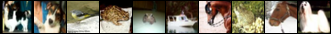

Train accuracy of deer = 22.46%
Hard negatives for deer


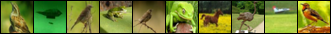

Train accuracy of dog = 30.02%
Hard negatives for dog


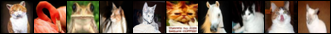

Train accuracy of frog = 49.08%
Hard negatives for frog


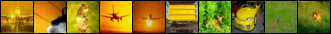

Train accuracy of horse = 20.90%
Hard negatives for horse


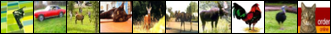

Train accuracy of ship = 54.54%
Hard negatives for ship


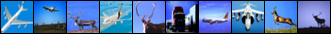

Train accuracy of truck = 47.70%
Hard negatives for truck


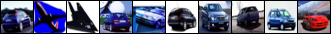


Test accuracy of the network: 32.27%
Test accuracy of plane = 49.20%
Hard negatives for plane


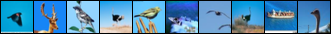

Test accuracy of car = 30.80%
Hard negatives for car


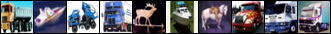

Test accuracy of bird = 4.30%
Hard negatives for bird


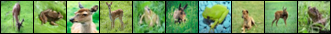

Test accuracy of cat = 12.90%
Hard negatives for cat


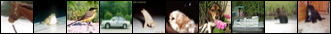

Test accuracy of deer = 22.70%
Hard negatives for deer


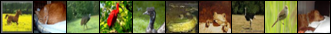

Test accuracy of dog = 29.60%
Hard negatives for dog


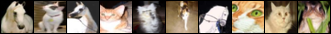

Test accuracy of frog = 50.70%
Hard negatives for frog


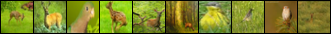

Test accuracy of horse = 21.40%
Hard negatives for horse


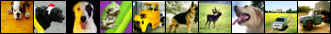

Test accuracy of ship = 56.00%
Hard negatives for ship


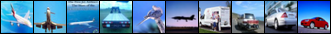

Test accuracy of truck = 45.10%
Hard negatives for truck


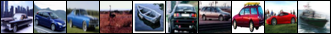


Epoch 40 summary -- loss = 0.083



Epoch 41 summary -- loss = 0.083



Epoch 42 summary -- loss = 0.083



Epoch 43 summary -- loss = 0.082



Epoch 44 summary -- loss = 0.082



Epoch 45 summary -- loss = 0.082



Epoch 46 summary -- loss = 0.082



Epoch 47 summary -- loss = 0.082



Epoch 48 summary -- loss = 0.082



Epoch 49 summary -- loss = 0.082
Evaluating epoch 50



Train accuracy of the network: 33.58%
Train accuracy of plane = 45.64%
Hard negatives for plane


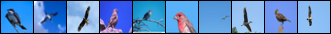

Train accuracy of car = 34.88%
Hard negatives for car


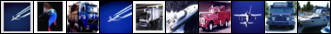

Train accuracy of bird = 5.94%
Hard negatives for bird


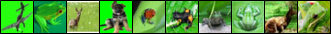

Train accuracy of cat = 12.60%
Hard negatives for cat


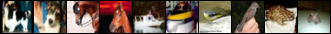

Train accuracy of deer = 24.74%
Hard negatives for deer


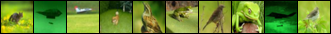

Train accuracy of dog = 33.20%
Hard negatives for dog


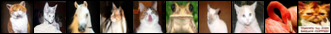

Train accuracy of frog = 49.88%
Hard negatives for frog


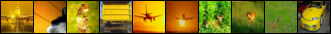

Train accuracy of horse = 24.02%
Hard negatives for horse


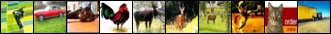

Train accuracy of ship = 55.80%
Hard negatives for ship


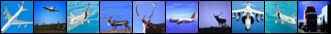

Train accuracy of truck = 49.10%
Hard negatives for truck


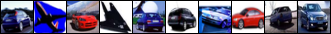


Test accuracy of the network: 33.81%
Test accuracy of plane = 49.20%
Hard negatives for plane


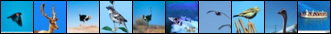

Test accuracy of car = 34.60%
Hard negatives for car


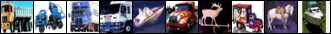

Test accuracy of bird = 6.10%
Hard negatives for bird


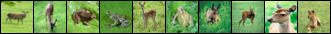

Test accuracy of cat = 11.90%
Hard negatives for cat


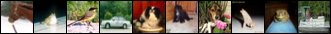

Test accuracy of deer = 23.30%
Hard negatives for deer


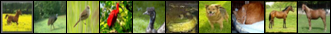

Test accuracy of dog = 32.50%
Hard negatives for dog


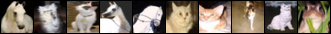

Test accuracy of frog = 51.60%
Hard negatives for frog


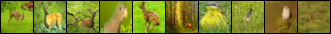

Test accuracy of horse = 24.50%
Hard negatives for horse


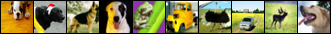

Test accuracy of ship = 57.10%
Hard negatives for ship


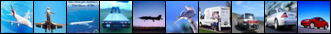

Test accuracy of truck = 47.30%
Hard negatives for truck


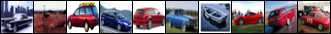

In [64]:
class MSELossClassification(nn.Module):
  def forward(self, output, labels):
    one_hot_encoded_labels = \
      torch.nn.functional.one_hot(labels, num_classes=output.shape[1]).float()
    return nn.functional.mse_loss(output, one_hot_encoded_labels)

net = CoolNet()
train_losses, train_accuracies, test_accuracies = train_network(
    net, 
    criterion=MSELossClassification(),
    lr=0.01, 
    epochs=50, 
    batch_size=1024)

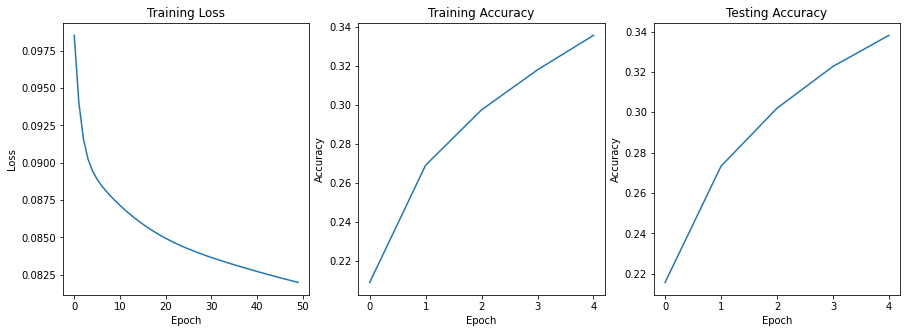

In [66]:
plot_results(train_losses, train_accuracies, test_accuracies)

**Question**:
How does this affects the results? Explain why you think this is happening.

Mean Squared Error loss has lower training loss than Cross Entropy. However, Cross Entropy has higher accuracy and perfrom better at classification.

## Turning In

You're done! You just need to turn in the notebook file.

Go to `File > Download .ipynb` and download the file as `hw4.ipynb`. Turn in only this file.

Make sure that you've answered all questions and all plots are correct.